# Preparing RV data for joint fit

Need to find tight priors on the background velocity, the effect of the outer companion, and the systematic normalizations and offset of the measurements.

In [498]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt

import OoT_fix.oot as oot
import scipy.misc as sMisc
from astropy.stats import LombScargle
import pylanet.data as pydata
import pylanet.model as pymodel
import pylanet.plot as pyplot
import astropy.units as u

import emcee
import corner
import splitnormal.splitnormal as split


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [409]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.style.use('ggplot')
mpl.rcParams['lines.linewidth'] = 3.5
mpl.rcParams['axes.facecolor']='white'
mpl.rcParams['axes.edgecolor']='white'
mpl.rcParams['axes.linewidth']=2

mpl.rcParams['text.color'] = 'dimgrey'
#mpl.rcParams['xtick.major.width'] = 2
#mpl.rcParams['ytick.major.width'] = 2
mpl.rcParams['xtick.color']='k'
mpl.rcParams['ytick.color']='k'
mpl.rcParams['axes.labelcolor']='k'

mpl.rcParams['font.size']=14
mpl.rcParams['xtick.direction']='in'
mpl.rcParams['ytick.direction']='in'
mpl.rcParams['xtick.major.size'] = 5.5
mpl.rcParams['ytick.major.size'] = 5.5
mpl.rcParams['xtick.minor.size'] = 3.5
mpl.rcParams['ytick.minor.size'] = 3.5

mpl.rcParams["text.usetex"] = True

In [594]:
def sigString(number,significantFigures,extra=False): # returns a number to a given significant digits (if extra is true also returns base of first significant figure)
    roundingFactor=significantFigures - int(np.floor(np.log10(np.abs(number)))) - 1
    rounded=np.round(number, roundingFactor)
    # np.round retains a decimal point even if the number is an integer (i.e. we might expect 460 but instead get 460.0)
    if roundingFactor<=0:
        rounded=rounded.astype(int)
    string=rounded.astype(str)
    if extra==False:
        return string
    if extra==True:
        return string,roundingFactor
    
print(sigString(4567.89,3,extra=True))

('4570', -1)


In [7]:
kep2=pydata.getData(2.01,'./data/',cadence='long')

Target: KIC 10666592.
0 data files.
downloading file  0  of  67
downloading file  5  of  67
downloading file  10  of  67
downloading file  15  of  67
downloading file  20  of  67
downloading file  25  of  67
downloading file  30  of  67
downloading file  35  of  67
downloading file  40  of  67
downloading file  45  of  67
downloading file  50  of  67
downloading file  55  of  67
downloading file  60  of  67
downloading file  65  of  67
67 light curve files downloaded.
cadence is long
period is 2.204735417


In [136]:
rawTs=kep2.times
rawFs=kep2.sap_fluxs
rawEs=kep2.sap_flux_errs
period=kep2.period

In [137]:
cTs,cFs,cEs=pydata.cleanData(rawTs,rawFs,rawEs,period,nMin=512,detrendMethod='boxMean')
ts,fs,es=pydata.stackData(cTs,cFs,cEs,period,nTs=512)

0.09912678672707886

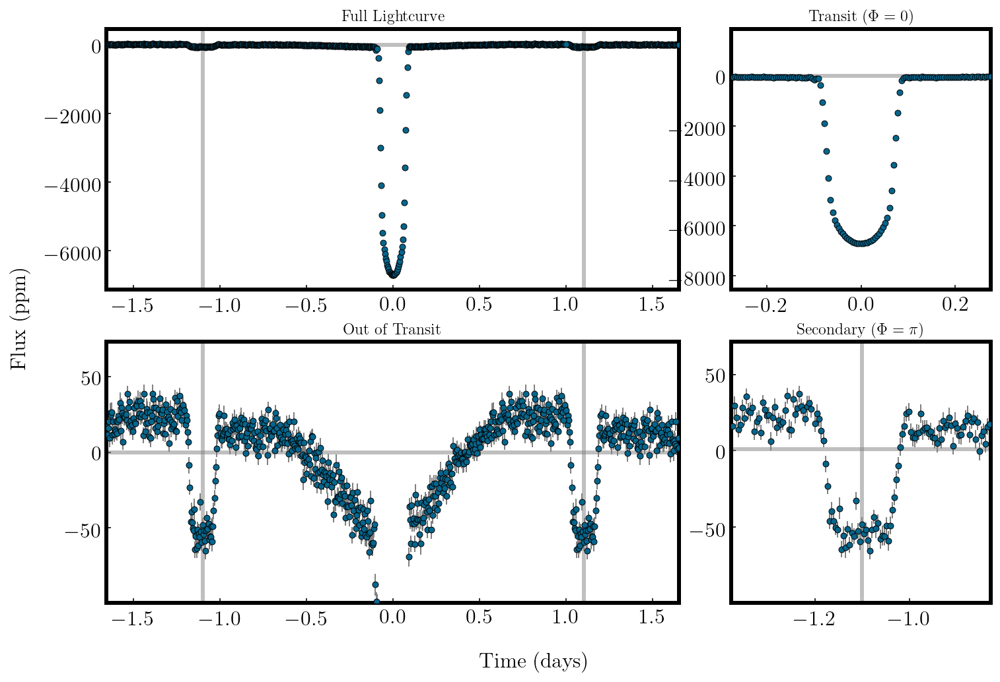

In [138]:
thisFig,thisGrid=pyplot.makeFig()
pyplot.plotData(thisGrid,ts,fs,es,period=period)

In [689]:
from astroquery.vizier import Vizier
Vizier.ROW_LIMIT = -1

# HIRES/Keck (corrected) - From Tal-Or+ 2019 - https://ui.adsabs.harvard.edu/abs/2019MNRAS.484L...8T/abstract
# this data has an oversampled region around 2455402 days for checking RM effect that must be removed to avoid overfitting
keckData = Vizier.get_catalogs("J/MNRAS/484/L8/table1")[0]
thisStar=np.flatnonzero((keckData['Name']=='HTR154-011') & ((keckData['BJD']<2455401.6342168534) | (keckData['BJD']>2455402.1342168534)))
rvTs=np.array(keckData['BJD'][thisStar])
rvVs=np.array(keckData['RVcor'][thisStar])
rvEs=np.array(keckData['e_RVcor'][thisStar])
rvIs=np.tile('Keck', rvTs.size)

'''# HIRES/Keck - From Knutson+ 2014 - https://ui.adsabs.harvard.edu/abs/2014ApJ...785..126K/abstract
keckData = Vizier.get_catalogs("J/ApJ/785/126/table3")[0]
thisStar=np.flatnonzero(table['Name']=='HAT-P-7')
rvTs=np.array(table['BJD'][thisStar])
rvVs=np.array(table['RV'][thisStar])
rvEs=np.array(table['e_RV'][thisStar])
rvIs=np.tile('Keck',rvTs.size)'''


# HARPS-N - From Bonomo+ 2017 - https://ui.adsabs.harvard.edu/abs/2017A%26A...602A.107B/abstract
harpsData = Vizier.get_catalogs("J/A+A/602/A107/table1")[0]
thisStar=np.flatnonzero(harpsData['Star']=='HAT-P-7')
rvTs=np.hstack([rvTs,np.array(harpsData['BJD'][thisStar]+2450000)])
rvVs=np.hstack([rvVs,np.array(harpsData['RV'][thisStar]*1e3)])
rvEs=np.hstack([rvEs,np.array(harpsData['e_RV'][thisStar]*1e3)])
rvIs=np.hstack([rvIs,np.tile('HARPS-N',thisStar.size)])

# SOPHIE - From Husnoo+ 2012 - https://ui.adsabs.harvard.edu/abs/2012MNRAS.422.3151H/abstract
sophieRvTs=np.array([5002.48517,5003.52118,5004.59910,5005.49926,5006.55335,5007.53107,5008.47624,5010.43095,5011.52259,5013.60648,5014.57426,5015.58518,5016.54123]) + 2450000 # in BJD
sophieRvVs=np.array([-10.2995,-10.6910,-10.2681,-10.6377,-10.2564,-10.5975,-10.4027,-10.5681,-10.3835,-10.3090,-10.6862,-10.2680,-10.6808])*1e3 # in ms-1
sophieRvEs=np.array([0.0100,0.0103,0.0137,0.0101,0.0101,0.0101,0.0106,0.0102,0.0102,0.0093,0.0101,0.0103,0.0084])*1e3 # in ms-1

rvTs=np.hstack([rvTs,sophieRvTs])
rvVs=np.hstack([rvVs,sophieRvVs])
rvEs=np.hstack([rvEs,sophieRvEs])
rvIs=np.hstack([rvIs,np.tile('SOPHIE',sophieRvTs.size)])

t0:  2455772.3026422337


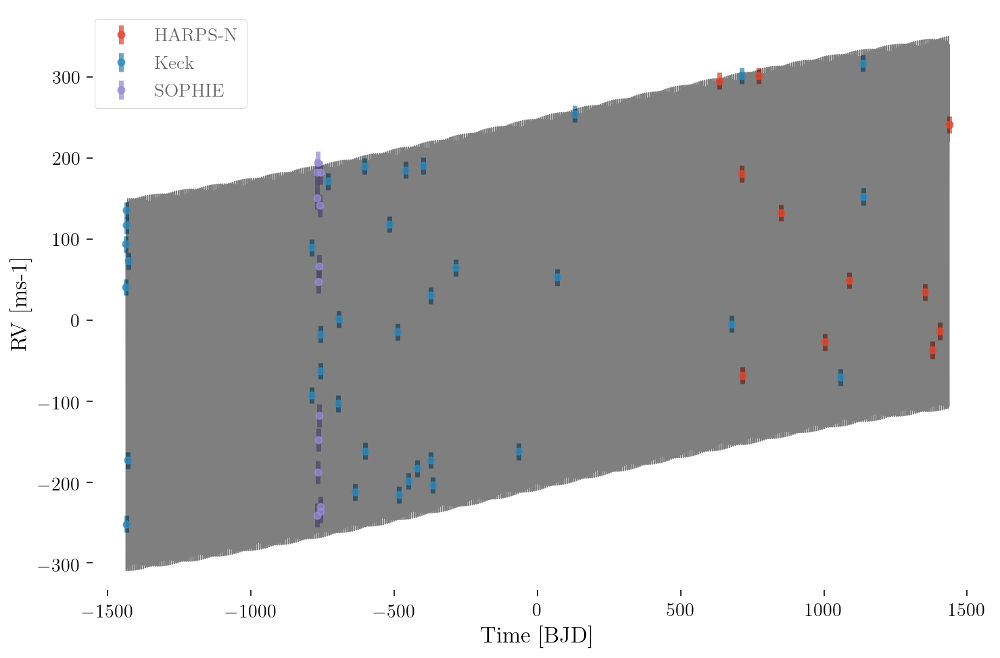

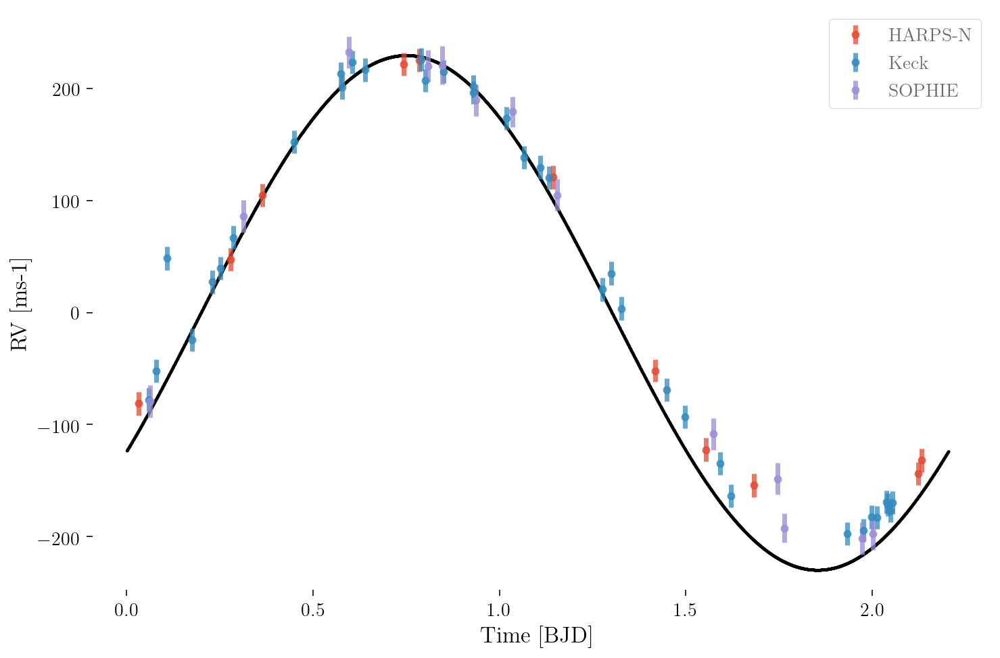

In [691]:
deltaHarps=10500
deltaSophie=10450
jitterHarps=10
jitterSophie=10
jitterKeck=10

t0=0.5*(np.min(rvTs)+np.max(rvTs))-0.4*period #date of middle transit
print('t0: ',t0)
v0=20 #const vel offset
a0=8e-2 #rate of change of vel offset
b0=8e-12 #rate of change of rate of change
c0=-5e-9 #rate of change of rate of change of rate of change

v=230
P=period

crvVs=1.0*rvVs
crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)



crvTs=rvTs-t0

mTs=np.linspace(np.min(rvTs),np.max(rvTs),10000)
offsetVel=v0+a0*(mTs-t0)+c0*(mTs-t0)**3
offsetData=v0+a0*(rvTs-t0)+c0*(rvTs-t0)**3

innerVel=v*np.sin(2*np.pi*(t0-mTs)/P)


fullFig=plt.figure(figsize=(12,8))
fullPlot=plt.gca()
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    fullPlot.errorbar(crvTs[thisInst],crvVs[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
fullPlot.plot(mTs-t0,offsetVel+innerVel,c='k',lw=1,alpha=0.5)
fullPlot.set_xlabel('Time [BJD]')
fullPlot.set_ylabel('RV [ms-1]')
plt.legend()
plt.show()


periodFig=plt.figure(figsize=(12,8))
periodPlot=plt.gca()
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    periodPlot.errorbar(rvTs[thisInst]%period,crvVs[thisInst]-offsetData[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
periodPlot.scatter(mTs%period,innerVel,c='k',lw=1,alpha=0.5,s=1)
periodPlot.set_xlabel('Time [BJD]')
periodPlot.set_ylabel('RV [ms-1]')
plt.legend()
plt.show()

In [695]:
def mapXs(x): #maps 0->1 to appropriate parameter values
    newX=np.copy(x)
    if len(newX.shape)==1:
        newX=newX[np.newaxis,:]
    newX[:,0]=0.5*(np.min(rvTs)+np.max(rvTs))-0.44*period+0.08*period*newX[:,0] #t0
    newX[:,1]=-20+80*newX[:,1] #v0
    newX[:,2]=-0.05+0.3*newX[:,2] #a0
    newX[:,3]=-2e-8+3e-8*newX[:,3] #c0
    newX[:,4]=0.99995*period+0.0001*period*newX[:,4] #P
    newX[:,5]=180+60*newX[:,5] #v
    newX[:,6]=10450+200*newX[:,6] #deltaHarps
    newX[:,7]=10400+100*newX[:,7] #deltaSophie
    newX[:,8]=40*newX[:,8] # jitterHarps
    newX[:,9]=40*newX[:,9] # jitterSophie
    newX[:,10]=40*newX[:,10] # jitterKeck
    if len(x.shape)==1:
        return newX[0,:]
    return newX

def priors(x):
    if (np.min(x)<0) | (np.max(x)>1):
        return -np.inf
    else:
        return 0.0
    
def lnprob(x,rvTs,rvVs,rvEs,rvIs):
    """The log-likelihood function."""
    prior=priors(x) # all x between 0 and 1
    if prior<0:
        return prior
    x=mapXs(x) # maps them to appropriate parameter values
    
    #preparing the data
    crvVs=1.*rvVs
    deltaHarps=x[6]
    deltaSophie=x[7]
    jitterHarps=x[8]
    jitterSophie=x[9]
    jitterKeck=x[10]
    
    crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
    crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
    crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
    crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
    crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)
    
    t0=x[0]
    v0=x[1]
    a0=x[2]
    c0=x[3]
    P=x[4]
    v=x[5]
    
    modelVs= v0 + a0*(rvTs-t0) + c0*(rvTs-t0)**3 + v*np.sin(2*np.pi*(t0-rvTs)/P)
    deltas=crvVs-modelVs
    residual=np.power(deltas/crvEs,2)
    lnpre=np.log(1/np.sqrt(2*np.pi*crvEs**2))
    return -(np.sum(residual)/2) +np.sum(lnpre) + prior
    #return -(np.sum(residual)/2) + prior

ndim, nwalkers = 11, 256
p0=np.random.rand(ndim * nwalkers).reshape((nwalkers, ndim))

nSteps = 1024
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob,args=[rvTs,rvVs,rvEs,rvIs])
pos, prob, state=sampler.run_mcmc(p0,nSteps)

$t_0 \ [BJD]$
(2455772.313530651, 0.0038349051028490067, 0.0043166340328752995)
$v_0 \ [ms^{-1}]$
(39.87128631564586, 2.9534299659887466, 4.347089535009005)
$a_0 \ [ms^{-1}day^{-1}]$
(0.0889379545621924, 0.006832350558609174, 0.008331529858220083)
$c_0 \ [ms^{-1}day^{-3}]$
(-3.636296312095108e-09, 3.3443583138681397e-09, 3.1718293341163302e-09)
$P \ [day]$
(2.2047321433906246, 1.0707568312007254e-05, 6.7501522180712925e-06)
$v \ [ms^{-1}]$
(212.99487023942527, 2.5104518913848324, 1.7619246984626216)
$\Delta_{HARPS} \ [ms^{-1}]$
(10517.924493128889, 8.040660390877747, 6.658813894367995)
$\Delta_{SOPHIE} \ [ms^{-1}]$
(10444.155113008119, 6.434682219080059, 6.614676124434482)
$\sigma_{HARPS} \ [ms^{-1}]$
(3.394089221237302, 0.8779417763831887, 3.295774464364074)
$\sigma_{SOPHIE} \ [ms^{-1}]$
(12.205899544962849, 2.585517448070263, 7.366892244078043)
$\sigma_{Keck} \ [ms^{-1}]$
(16.562285523223267, 2.00266330858644, 2.4808159938472514)


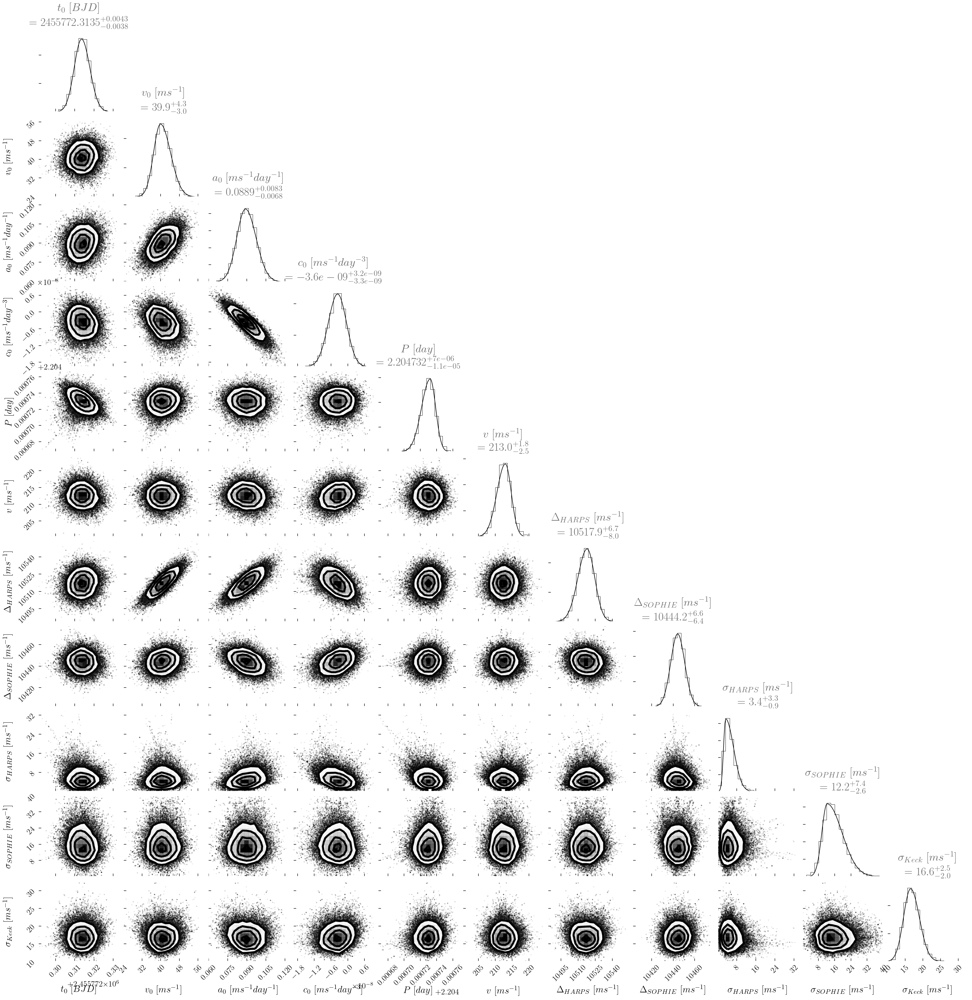

In [696]:
samples = sampler.chain[:,int(nSteps/2):,:].reshape((-1, ndim))
#truths=[np.log10(1.56),np.log10(0.002),np.log10(2),np.log10(0.155),np.log10(0.006),0.2,0,0.5,0,0]
labels=[r'$t_0 \ [BJD]$',r'$v_0 \ [ms^{-1}]$',r'$a_0 \ [ms^{-1}day^{-1}]$',r'$c_0 \ [ms^{-1}day^{-3}]$',r'$P \ [day]$',r'$v \ [ms^{-1}]$',r'$\Delta_{HARPS} \ [ms^{-1}]$',r'$\Delta_{SOPHIE} \ [ms^{-1}]$',r'$\sigma_{HARPS} \ [ms^{-1}]$',r'$\sigma_{SOPHIE} \ [ms^{-1}]$',r'$\sigma_{Keck} \ [ms^{-1}]$']
mapped=mapXs(samples)
for i in range(ndim):
    print(labels[i])
    print(split.fit(mapped[:,i]))
fig = corner.corner(mapped,labels=labels,range=1.0*np.ones(ndim))
axes = np.array(fig.axes).reshape((ndim, ndim))
# Loop over the diagonal
for i in range(ndim):
    mu,sigma,cigma=split.fit(mapped[:,i])
    ax = axes[i, i]
    xlim=ax.get_xlim()
    ylim=ax.get_ylim()
    plotXs=np.linspace(xlim[0],xlim[1],100)
    norm=0.9*ylim[1]/split.splitNormal(np.array([mu]),mu,sigma,cigma)
    ax.plot(plotXs,norm*split.splitNormal(plotXs,mu,sigma,cigma),c='k',lw=1)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    
    cigmaString,cigmaDec=sigString(cigma,2,extra=True)
    sigmaString,sigmaDec=sigString(sigma,2,extra=True)
    muSigFigs=np.min([cigmaDec,sigmaDec])
    muString=np.round(mu,muSigFigs)
    if muSigFigs<=0:
        muSigFigs=int(muSigFigs)
    cigmaString = "+{0}".format(np.round(cigma,muSigFigs))
    sigmaString = "-{0}".format(np.round(sigma,muSigFigs))
    titleString = r"{0}".format(labels[i])+"\n = ${"+str(muString)+"}^{"+cigmaString+"}_{"+sigmaString+"}$"
    ax.set_title(titleString)
    
plt.show()

Best log likelihood:  -237.61325584042407
__________ 0
$t_0 \ [BJD]$
2455772.3158229087
__________ 1
$v_0 \ [ms^{-1}]$
39.37702328752154
__________ 2
$a_0 \ [ms^{-1}day^{-1}]$
0.08744855044631784
__________ 3
$c_0 \ [ms^{-1}day^{-3}]$
-3.069279660376587e-09
__________ 4
$P \ [day]$
2.2047276716798363
__________ 5
$v \ [ms^{-1}]$
211.642445696692
__________ 6
$\Delta_{HARPS} \ [ms^{-1}]$
10514.439601224427
__________ 7
$\Delta_{SOPHIE} \ [ms^{-1}]$
10443.492336570527
__________ 8
$\sigma_{HARPS} \ [ms^{-1}]$
3.14194879698125
__________ 9
$\sigma_{SOPHIE} \ [ms^{-1}]$
13.282765898959447
__________ 10
$\sigma_{Keck} \ [ms^{-1}]$
15.991380202795911


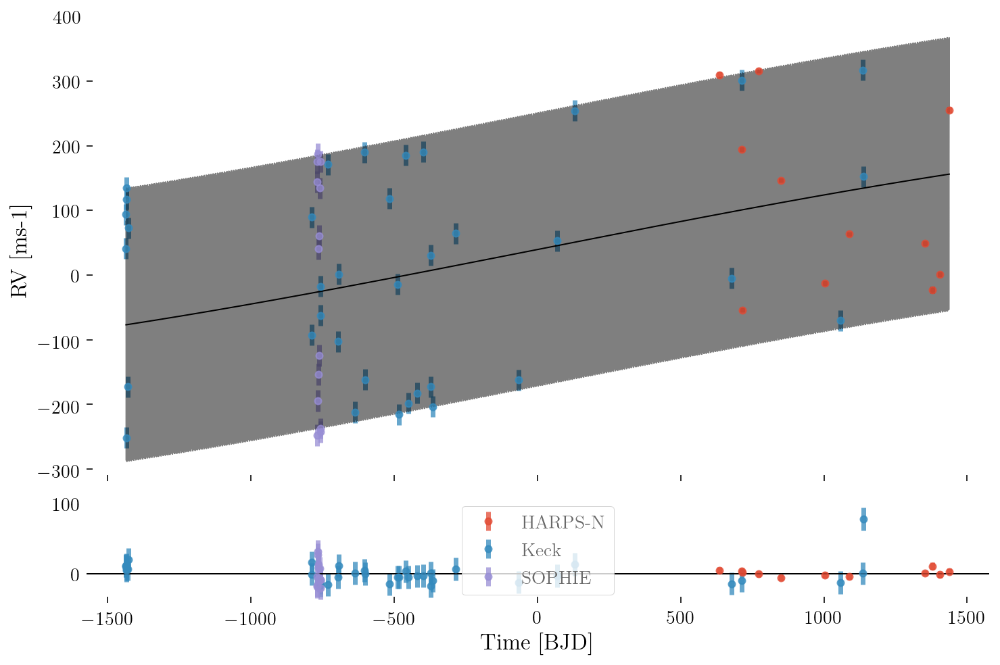

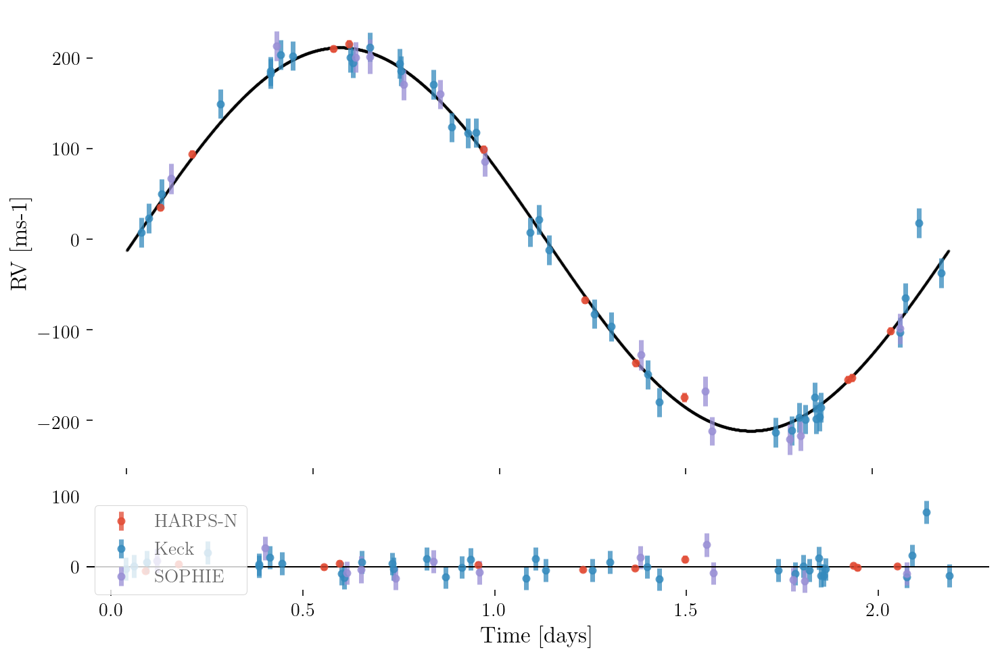

In [697]:
bestProb=np.max(sampler.lnprobability)
bestStep=np.argmax(sampler.lnprobability)
bestX=sampler.chain.reshape((-1, ndim))[bestStep,:]

#bestX=pos[np.argsort(prob)[-1],:]
print('Best log likelihood: ',bestProb)
x=mapXs(bestX)
for i in range(x.size):
    print('__________',i)
    print(labels[i])
    print(x[i])

crvVs=1.0*rvVs
deltaHarps=x[6]
deltaSophie=x[7]
jitterHarps=x[8]
jitterSophie=x[9]
jitterKeck=x[10]
crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)
    
t0=x[0]
v0=x[1]
a0=x[2]
c0=x[3]
P=x[4]
v=x[5]
    
crvTs=rvTs-t0

mTs=np.linspace(np.min(rvTs),np.max(rvTs),16000)
offsetVel=v0+a0*(mTs-t0)+c0*(mTs-t0)**3
offsetData=v0+a0*(rvTs-t0)+c0*(rvTs-t0)**3

innerVel=v*np.sin(2*np.pi*(t0-mTs)/P)
innerData=v*np.sin(2*np.pi*(t0-rvTs)/P)


fullFig=plt.figure(figsize=(12,8))
fullGrid=mpl.gridspec.GridSpec(5,1)
fullPlot=plt.subplot(fullGrid[:4,0])
fullRes=plt.subplot(fullGrid[4,0])
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    residual=(crvVs-innerData-offsetData)[thisInst]
    fullPlot.errorbar(crvTs[thisInst],crvVs[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
    fullRes.errorbar(crvTs[thisInst],residual,yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
fullPlot.set_xticklabels([])
plt.legend()
fullPlot.plot(mTs-t0,offsetVel+innerVel,c='k',lw=1,alpha=0.5)
fullPlot.plot(mTs-t0,offsetVel,c='k',lw=1)
fullRes.set_xlabel('Time [BJD]')
fullPlot.set_ylabel('RV [ms-1]')
fullRes.axhline(0,c='k',lw=1)
plt.show()


periodFig=plt.figure(figsize=(12,8))
periodGrid=mpl.gridspec.GridSpec(5,1)
periodPlot=plt.subplot(periodGrid[:4,0])
periodRes=plt.subplot(periodGrid[4,0])
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    residual=(crvVs-innerData-offsetData)[thisInst]
    periodPlot.errorbar(rvTs[thisInst]%P,crvVs[thisInst]-offsetData[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
    periodRes.errorbar(rvTs[thisInst]%P,residual,yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
periodPlot.set_xticklabels([])
plt.legend()
periodRes.axhline(0,c='k',lw=1)
periodPlot.scatter(mTs%P,innerVel,c='k',lw=1,alpha=0.1,s=1)
periodRes.set_xlabel('Time [days]')
periodPlot.set_ylabel('RV [ms-1]')
plt.show()

(256, 1024, 11)
(131072,)


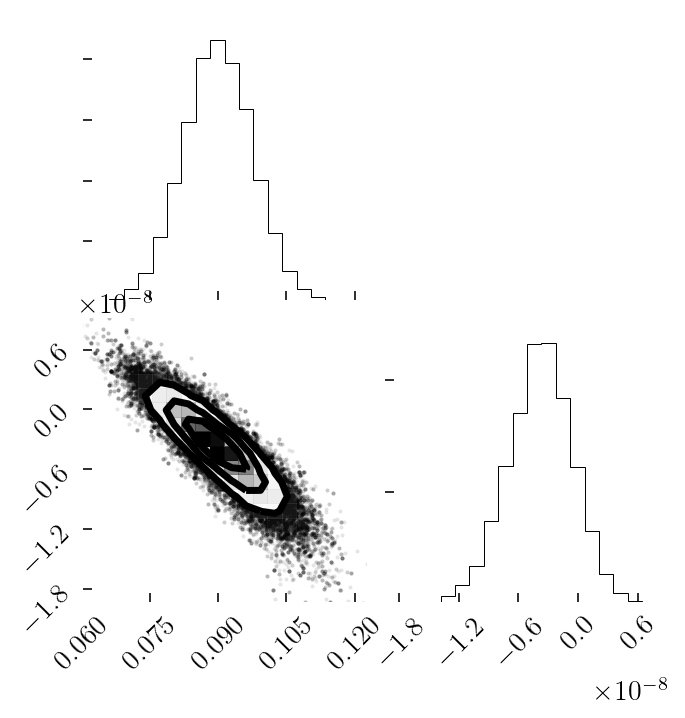

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in sqrt
  # Remove the CWD from sys.path while we load stuff.
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


[     0      1      2 ... 131069 131070 131071]
115740
mu:  4289.31640992298
mu:  30.71656766293006


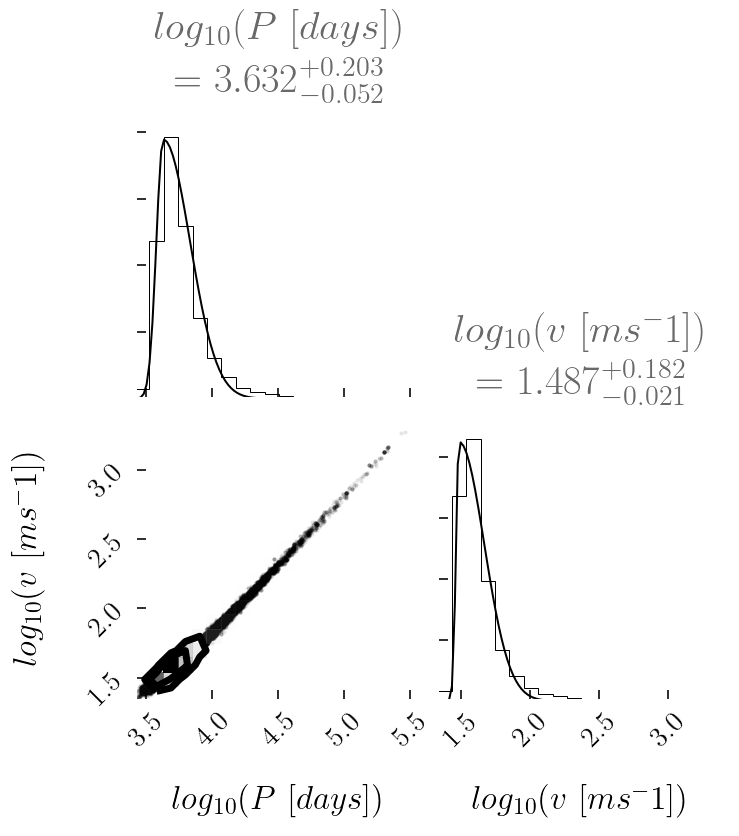

In [698]:
print(sampler.chain.shape)
a0s=mapped[:,2].flatten()
print(a0s.shape)
c0s=mapped[:,3].flatten()

twoDim=np.vstack([a0s,c0s]).T
fig = corner.corner(twoDim)
plt.show()

Ps=(1/2)*np.sqrt(-5*np.pi*a0s/(3*c0s))
vs=(1/8)*np.sqrt(-5*a0s**3/(3*np.pi*c0s))

finite=np.flatnonzero(np.isfinite(Ps+vs))
print(finite)
print(finite.size)

labels=[r'$log_{10}(P \ [days])$',r'$log_{10}(v \ [ms^-1])$']
twoDim=np.vstack([np.log10(Ps[finite]),np.log10(vs[finite])]).T
fig = corner.corner(twoDim,labels=labels)
axes = np.array(fig.axes).reshape((2, 2))

for i in range(2):
    mu,sigma,cigma=split.fit(twoDim[:,i])
    print('mu: ',10**mu)
    ax = axes[i, i]
    xlim=ax.get_xlim()
    ylim=ax.get_ylim()
    plotXs=np.linspace(xlim[0],xlim[1],100)
    norm=0.9*ylim[1]/split.splitNormal(np.array([mu]),mu,sigma,cigma)
    ax.plot(plotXs,norm*split.splitNormal(plotXs,mu,sigma,cigma),c='k',lw=1)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    cigmaString,cigmaDec=sigString(cigma,2,extra=True)
    sigmaString,sigmaDec=sigString(sigma,2,extra=True)
    muSigFigs=np.max([cigmaDec,sigmaDec])
    muString=np.round(mu,muSigFigs)
    if muSigFigs<=0:
        muSigFigs=int(muSigFigs)
    cigmaString = "+{0}".format(np.round(cigma,muSigFigs))
    sigmaString = "-{0}".format(np.round(sigma,muSigFigs))
    titleString = r"{0}".format(labels[i])+"\n = ${"+str(muString)+"}^{"+cigmaString+"}_{"+sigmaString+"}$"
    ax.set_title(titleString)
plt.show()

# Fitting with a full quadratic

t0:  2455772.3026422337


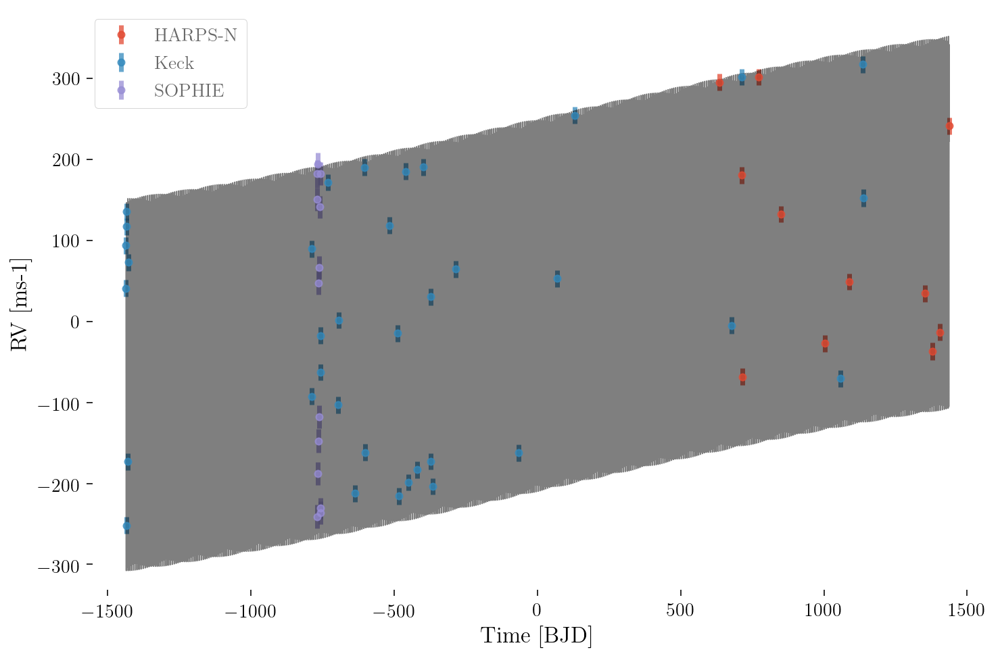

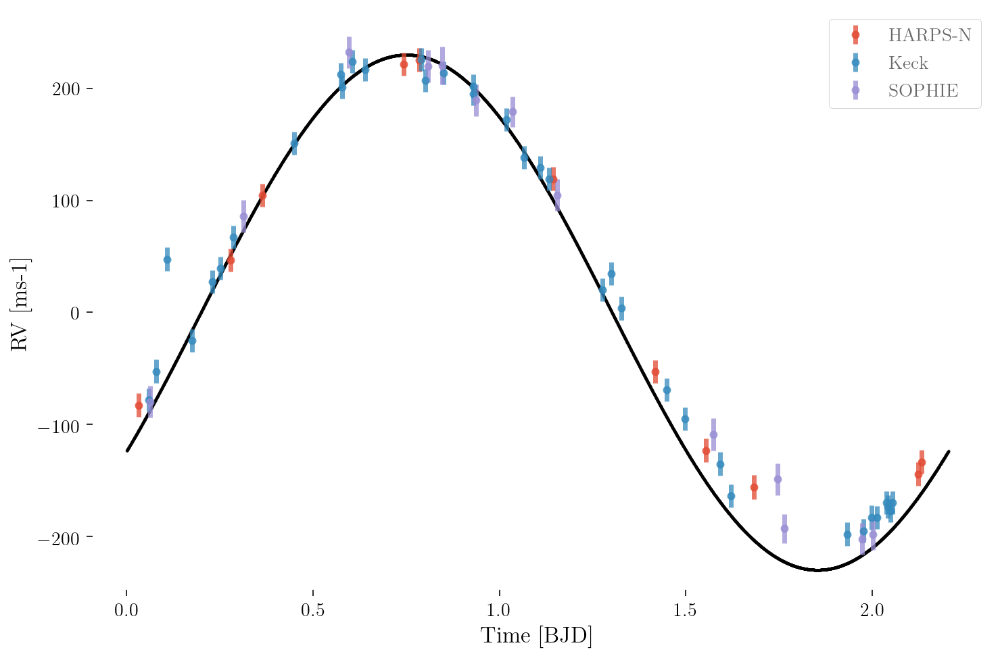

In [699]:
deltaHarps=10500
deltaSophie=10450
jitterHarps=10
jitterSophie=10
jitterKeck=10

t0=0.5*(np.min(rvTs)+np.max(rvTs))-0.4*period #date of middle transit
print('t0: ',t0)
v0=20 #const vel offset
a0=8e-2 #rate of change of vel offset
b0=8e-7 #rate of change of rate of change
c0=-5e-9 #rate of change of rate of change of rate of change

v=230
P=period

crvVs=1.0*rvVs
crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)



crvTs=rvTs-t0

mTs=np.linspace(np.min(rvTs),np.max(rvTs),10000)
offsetVel=v0+a0*(mTs-t0)+b0*(mTs-t0)**2+c0*(mTs-t0)**3
offsetData=v0+a0*(rvTs-t0)+b0*(rvTs-t0)**2+c0*(rvTs-t0)**3

innerVel=v*np.sin(2*np.pi*(t0-mTs)/P)


fullFig=plt.figure(figsize=(12,8))
fullPlot=plt.gca()
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    fullPlot.errorbar(crvTs[thisInst],crvVs[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
fullPlot.plot(mTs-t0,offsetVel+innerVel,c='k',lw=1,alpha=0.5)
fullPlot.set_xlabel('Time [BJD]')
fullPlot.set_ylabel('RV [ms-1]')
plt.legend()
plt.show()


periodFig=plt.figure(figsize=(12,8))
periodPlot=plt.gca()
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    periodPlot.errorbar(rvTs[thisInst]%period,crvVs[thisInst]-offsetData[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
periodPlot.scatter(mTs%period,innerVel,c='k',lw=1,alpha=0.5,s=1)
periodPlot.set_xlabel('Time [BJD]')
periodPlot.set_ylabel('RV [ms-1]')
plt.legend()
plt.show()

In [705]:
def mapXs(x): #maps 0->1 to appropriate parameter values
    newX=np.copy(x)
    if len(newX.shape)==1:
        newX=newX[np.newaxis,:]
    newX[:,0]=0.5*(np.min(rvTs)+np.max(rvTs))-0.44*period+0.08*period*newX[:,0] #t0
    newX[:,1]=-20+80*newX[:,1] #v0
    newX[:,2]=-0.05+0.3*newX[:,2] #a0
    newX[:,3]=-1e-5+3e-5*newX[:,3] #b0
    newX[:,4]=-2e-8+3e-8*newX[:,4] #c0
    newX[:,5]=0.99995*period+0.0001*period*newX[:,5] #P
    newX[:,6]=180+60*newX[:,6] #v
    newX[:,7]=10450+200*newX[:,7] #deltaHarps
    newX[:,8]=10400+100*newX[:,8] #deltaSophie
    newX[:,9]=40*newX[:,9] # jitterHarps
    newX[:,10]=40*newX[:,10] # jitterSophie
    newX[:,11]=40*newX[:,11] # jitterKeck
    if len(x.shape)==1:
        return newX[0,:]
    return newX

def priors(x):
    if (np.min(x)<0) | (np.max(x)>1):
        return -np.inf
    else:
        return 0.0
    
def lnprob(x,rvTs,rvVs,rvEs,rvIs):
    """The log-likelihood function."""
    prior=priors(x) # all x between 0 and 1
    if prior<0:
        return prior
    x=mapXs(x) # maps them to appropriate parameter values
    
    #preparing the data
    crvVs=1.*rvVs
    deltaHarps=x[7]
    deltaSophie=x[8]
    jitterHarps=x[9]
    jitterSophie=x[10]
    jitterKeck=x[11]
    
    crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
    crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
    crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
    crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
    crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)
    
    t0=x[0]
    v0=x[1]
    a0=x[2]
    b0=x[3]
    c0=x[4]
    P=x[5]
    v=x[6]
    
    modelVs= v0 + a0*(rvTs-t0) + b0*(rvTs-t0)**2 + c0*(rvTs-t0)**3 + v*np.sin(2*np.pi*(t0-rvTs)/P)
    deltas=crvVs-modelVs
    residual=np.power(deltas/crvEs,2)
    lnpre=np.log(1/np.sqrt(2*np.pi*crvEs**2))
    return -(np.sum(residual)/2) +np.sum(lnpre) + prior
    #return -(np.sum(residual)/2) + prior

ndim, nwalkers = 12, 256
p0=np.random.rand(ndim * nwalkers).reshape((nwalkers, ndim))

nSteps = 1024
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob,args=[rvTs,rvVs,rvEs,rvIs])
pos, prob, state=sampler.run_mcmc(p0,nSteps)

$t_0 \ [BJD]$
(2455772.3109356877, 0.003872848115861416, 0.0046119424514472485)
$v_0 \ [ms^{-1}]$
(35.85583594109278, 3.1866489369042625, 4.312723707183501)
$a_0 \ [ms^{-1}day^{-1}]$
(0.0920049460532202, 0.005990562371834235, 0.007744540440429826)
$b_0 \ [ms^{-1}day^{-2}]$
(7.184659049336822e-06, 3.459742699813161e-06, 2.015690828860934e-06)
$c_0 \ [ms^{-1}day^{-3}]$
(-5.438094099269354e-09, 3.4790774362077426e-09, 2.71754440205474e-09)
$P \ [day]$
(2.2047321675982916, 9.877848117678667e-06, 8.666499098364255e-06)
$v \ [ms^{-1}]$
(213.61955895696036, 2.6888522153512326, 1.8249554798072722)
$\Delta_{HARPS} \ [ms^{-1}]$
(10522.430450684767, 8.191210642065926, 5.316914088158228)
$\Delta_{SOPHIE} \ [ms^{-1}]$
(10441.34687803773, 5.556653223960893, 6.931302184171727)
$\sigma_{HARPS} \ [ms^{-1}]$
(3.454488197640753, 0.5978307616376304, 3.746805283900846)
$\sigma_{SOPHIE} \ [ms^{-1}]$
(12.013831015069494, 2.359627910044903, 7.143294587759366)
$\sigma_{Keck} \ [ms^{-1}]$
(14.752878369372413, 1

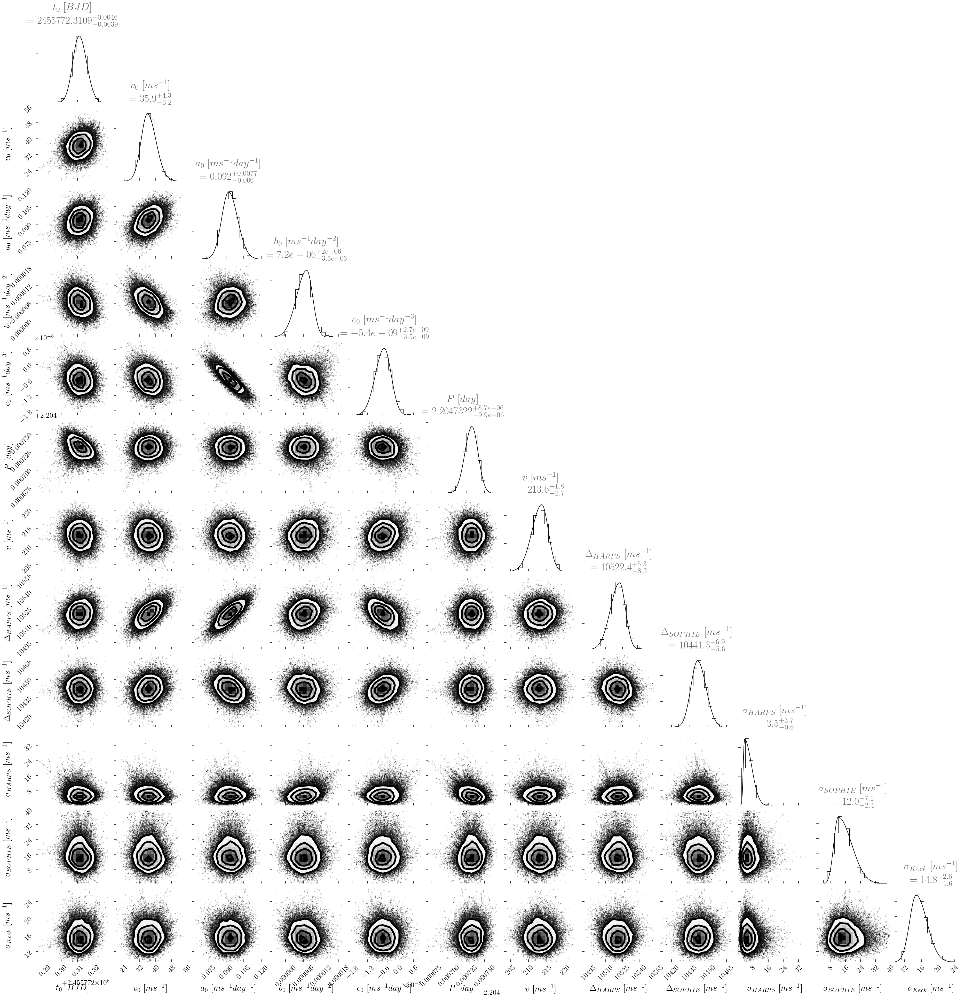

In [706]:
samples = sampler.chain[:,int(nSteps/2):,:].reshape((-1, ndim))
#truths=[np.log10(1.56),np.log10(0.002),np.log10(2),np.log10(0.155),np.log10(0.006),0.2,0,0.5,0,0]
labels=[r'$t_0 \ [BJD]$',r'$v_0 \ [ms^{-1}]$',r'$a_0 \ [ms^{-1}day^{-1}]$',r'$b_0 \ [ms^{-1}day^{-2}]$',r'$c_0 \ [ms^{-1}day^{-3}]$',r'$P \ [day]$',r'$v \ [ms^{-1}]$',r'$\Delta_{HARPS} \ [ms^{-1}]$',r'$\Delta_{SOPHIE} \ [ms^{-1}]$',r'$\sigma_{HARPS} \ [ms^{-1}]$',r'$\sigma_{SOPHIE} \ [ms^{-1}]$',r'$\sigma_{Keck} \ [ms^{-1}]$']
mapped=mapXs(samples)
for i in range(ndim):
    print(labels[i])
    print(split.fit(mapped[:,i]))
fig = corner.corner(mapped,labels=labels,range=1.0*np.ones(ndim))
axes = np.array(fig.axes).reshape((ndim, ndim))
# Loop over the diagonal
for i in range(ndim):
    mu,sigma,cigma=split.fit(mapped[:,i])
    ax = axes[i, i]
    xlim=ax.get_xlim()
    ylim=ax.get_ylim()
    plotXs=np.linspace(xlim[0],xlim[1],100)
    norm=0.9*ylim[1]/split.splitNormal(np.array([mu]),mu,sigma,cigma)
    ax.plot(plotXs,norm*split.splitNormal(plotXs,mu,sigma,cigma),c='k',lw=1)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    
    cigmaString,cigmaDec=sigString(cigma,2,extra=True)
    sigmaString,sigmaDec=sigString(sigma,2,extra=True)
    muSigFigs=np.min([cigmaDec,sigmaDec])
    muString=np.round(mu,muSigFigs)
    if muSigFigs<=0:
        muSigFigs=int(muSigFigs)
    cigmaString = "+{0}".format(np.round(cigma,muSigFigs))
    sigmaString = "-{0}".format(np.round(sigma,muSigFigs))
    titleString = r"{0}".format(labels[i])+"\n = ${"+str(muString)+"}^{"+cigmaString+"}_{"+sigmaString+"}$"
    ax.set_title(titleString)
    
plt.show()

Best log likelihood:  -234.68104464804915
__________ 0
$t_0 \ [BJD]$
2455772.309957593
__________ 1
$v_0 \ [ms^{-1}]$
37.56032080025047
__________ 2
$a_0 \ [ms^{-1}day^{-1}]$
0.09281425114874327
__________ 3
$b_0 \ [ms^{-1}day^{-2}]$
5.2568500994412855e-06
__________ 4
$c_0 \ [ms^{-1}day^{-3}]$
-5.844689254395523e-09
__________ 5
$P \ [day]$
2.204736453716332
__________ 6
$v \ [ms^{-1}]$
212.86617101441544
__________ 7
$\Delta_{HARPS} \ [ms^{-1}]$
10520.271787412961
__________ 8
$\Delta_{SOPHIE} \ [ms^{-1}]$
10443.283093864244
__________ 9
$\sigma_{HARPS} \ [ms^{-1}]$
4.0398590107038554
__________ 10
$\sigma_{SOPHIE} \ [ms^{-1}]$
12.79991296601839
__________ 11
$\sigma_{Keck} \ [ms^{-1}]$
14.09511668698271


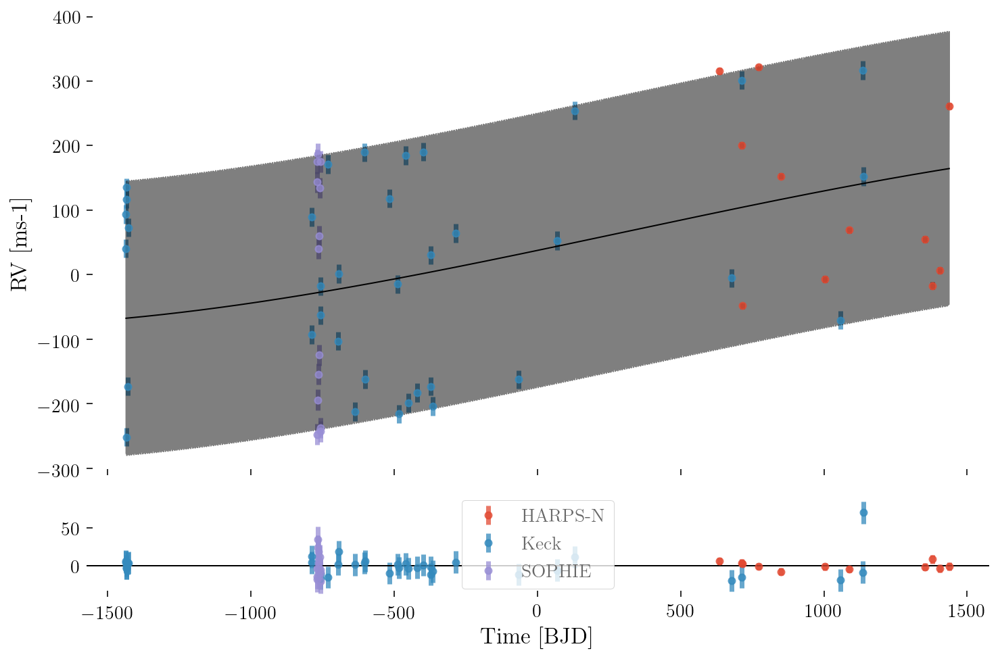

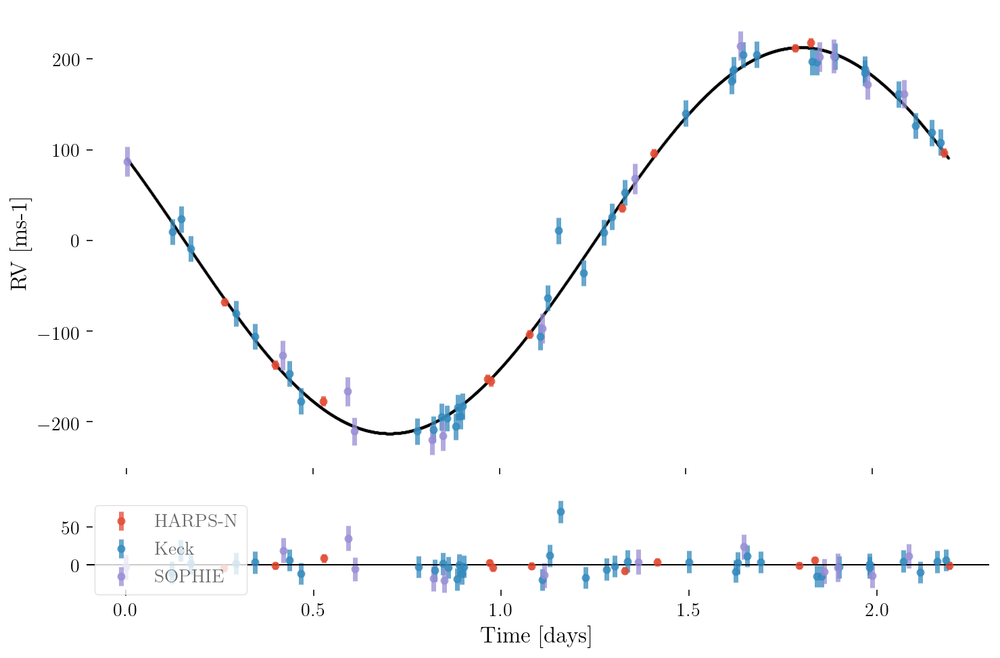

In [707]:
bestProb=np.max(sampler.lnprobability)
bestStep=np.argmax(sampler.lnprobability)
bestX=sampler.chain.reshape((-1, ndim))[bestStep,:]

#bestX=pos[np.argsort(prob)[-1],:]
print('Best log likelihood: ',bestProb)
x=mapXs(bestX)
for i in range(x.size):
    print('__________',i)
    print(labels[i])
    print(x[i])

crvVs=1.0*rvVs
deltaHarps=x[7]
deltaSophie=x[8]
jitterHarps=x[9]
jitterSophie=x[10]
jitterKeck=x[11]
crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)
    
t0=x[0]
v0=x[1]
a0=x[2]
b0=x[3]
c0=x[4]
P=x[5]
v=x[6]
    
crvTs=rvTs-t0

mTs=np.linspace(np.min(rvTs),np.max(rvTs),16000)
offsetVel=v0+a0*(mTs-t0)+b0*(mTs-t0)**2+c0*(mTs-t0)**3
offsetData=v0+a0*(rvTs-t0)+b0*(rvTs-t0)**2+c0*(rvTs-t0)**3

innerVel=v*np.sin(2*np.pi*(t0-mTs)/P)
innerData=v*np.sin(2*np.pi*(t0-rvTs)/P)


fullFig=plt.figure(figsize=(12,8))
fullGrid=mpl.gridspec.GridSpec(5,1)
fullPlot=plt.subplot(fullGrid[:4,0])
fullRes=plt.subplot(fullGrid[4,0])
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    residual=(crvVs-innerData-offsetData)[thisInst]
    fullPlot.errorbar(crvTs[thisInst],crvVs[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
    fullRes.errorbar(crvTs[thisInst],residual,yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
fullPlot.set_xticklabels([])
plt.legend()
fullPlot.plot(mTs-t0,offsetVel+innerVel,c='k',lw=1,alpha=0.5)
fullPlot.plot(mTs-t0,offsetVel,c='k',lw=1)
fullRes.set_xlabel('Time [BJD]')
fullPlot.set_ylabel('RV [ms-1]')
fullRes.axhline(0,c='k',lw=1)
plt.show()


periodFig=plt.figure(figsize=(12,8))
periodGrid=mpl.gridspec.GridSpec(5,1)
periodPlot=plt.subplot(periodGrid[:4,0])
periodRes=plt.subplot(periodGrid[4,0])
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    residual=(crvVs-innerData-offsetData)[thisInst]
    periodPlot.errorbar(rvTs[thisInst]%P,crvVs[thisInst]-offsetData[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
    periodRes.errorbar(rvTs[thisInst]%P,residual,yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
periodPlot.set_xticklabels([])
plt.legend()
periodRes.axhline(0,c='k',lw=1)
periodPlot.scatter(mTs%P,innerVel,c='k',lw=1,alpha=0.1,s=1)
periodRes.set_xlabel('Time [days]')
periodPlot.set_ylabel('RV [ms-1]')
plt.show()

(256, 1024, 12)


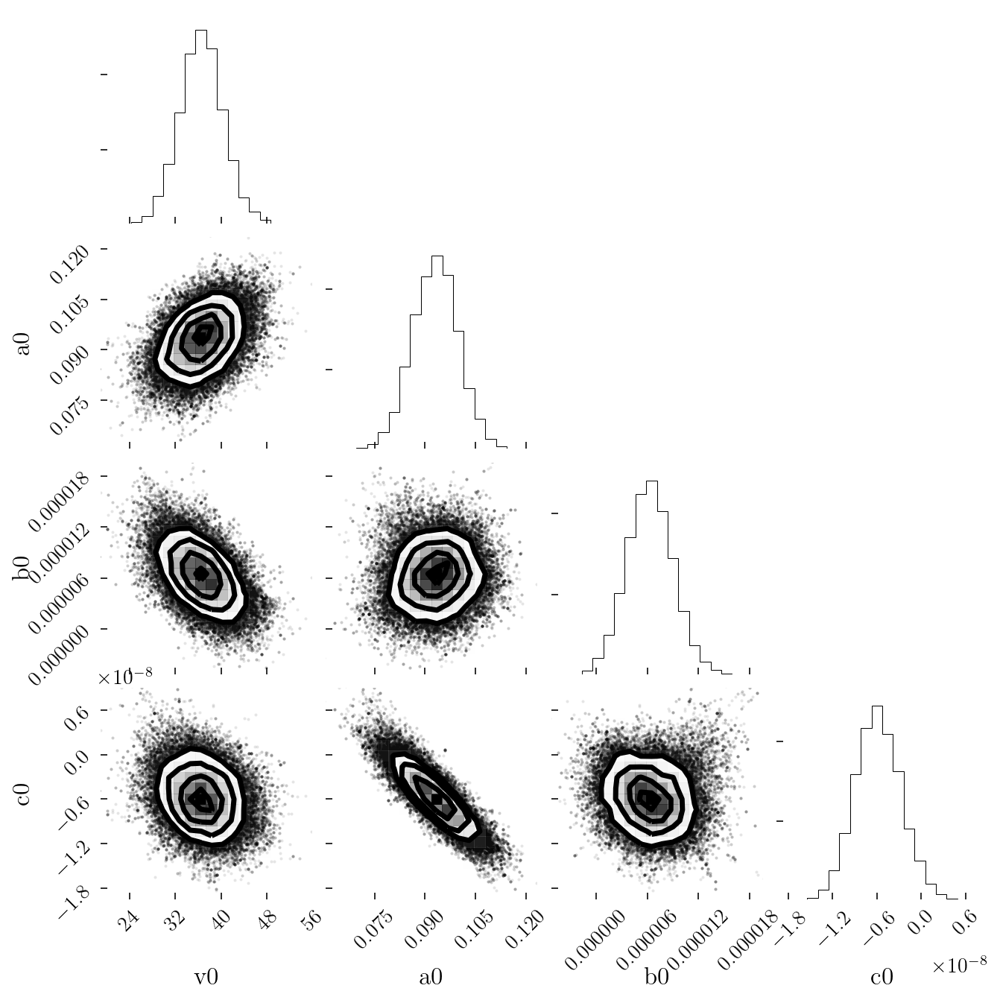

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in sqrt
  if sys.path[0] == '':
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in sqrt
  del sys.path[0]
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in power
  
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in power
  from ipykernel import kernelapp as app


[     0      1      2 ... 131069 131070 131071]
126070
$P \ [days]$
mu log:  inf
mu lin:  7943.791319701461
$v \ [ms^{-1}]$
mu log:  inf
mu lin:  754.247528275412
$t_1 [BJD]$
mu log:  1471.2679282343938
mu lin:  3.1676917680083836
$v_1 \ [ms^{-1}]$
mu log:  4.998071964848776e+17
mu lin:  17.69880250503407


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:34: RuntimeWarning: overflow encountered in double_scalars


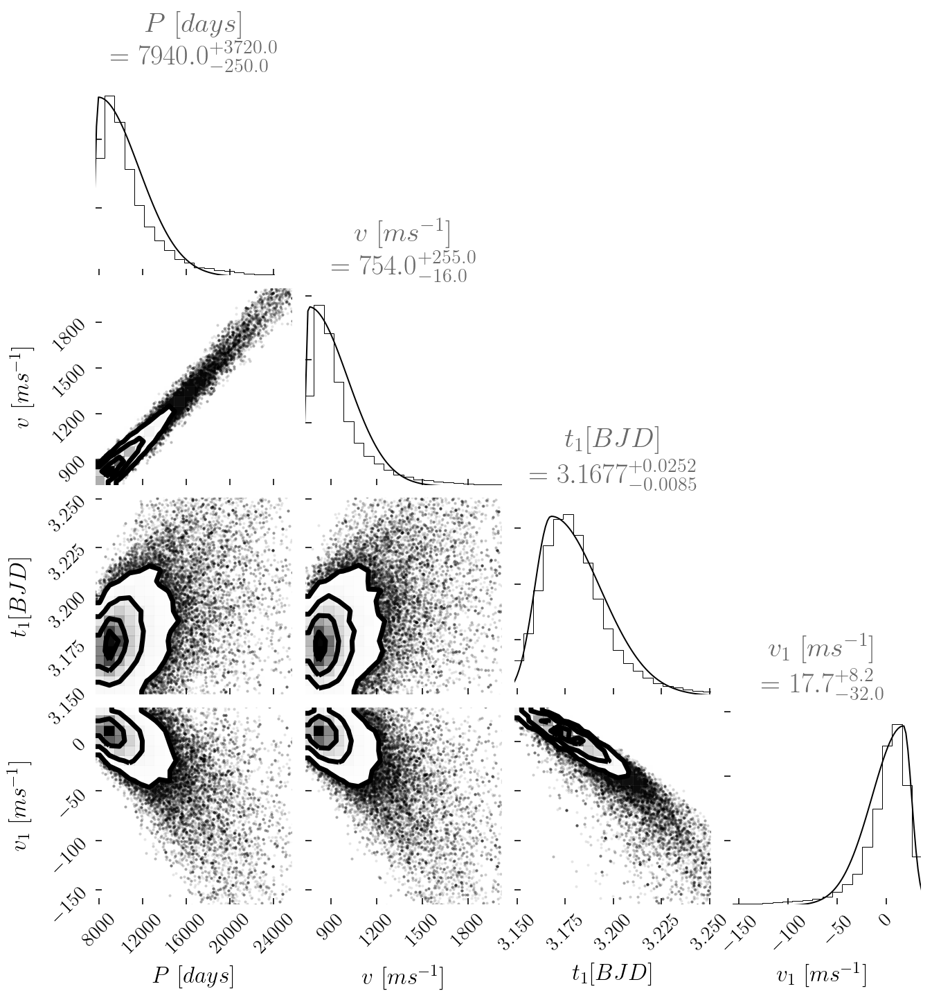

In [784]:
print(sampler.chain.shape)
a0s=mapped[:,2].flatten()
b0s=mapped[:,3].flatten()
c0s=mapped[:,4].flatten()
v0s=mapped[:,1].flatten()
t0s=mapped[:,0].flatten()

fourDim=np.vstack([v0s,a0s,b0s,c0s]).T
fig = corner.corner(fourDim,labels=['v0','a0','b0','c0'])
plt.show()

Ps=2*np.pi*np.sqrt(-a0s/(6*c0s))
vs=-(a0s*b0s/(3*c0s))*np.sqrt(1-54*a0s*c0s/b0s**2)
sinDeltas=np.sign(-b0s)*np.power(1-(54*a0s*c0s/b0s**2),-1/2)
cosDeltas=-np.power(1-b0s**2/(54*a0s*c0s),-1/2)
Deltas=np.arctan2(sinDeltas,cosDeltas)%(2*np.pi)
deltas=Ps*Deltas/(2*np.pi)
t1s=deltas+t0s

v1s=v0s+a0s*b0s/(3*c0s)

finite=np.flatnonzero(a0s*c0s<0) # otherwise period is undefined
print(finite)
print(finite.size)

labels=[r'$P \ [days]$',r'$v \ [ms^{-1}]$',r'$t_1 [BJD]$',r'$v_1 \ [ms^{-1}]$']
fourDim=np.vstack([Ps[finite],vs[finite],Deltas[finite],v1s[finite]]).T
fig = corner.corner(fourDim,labels=labels,range=0.95*np.ones(4))
axes = np.array(fig.axes).reshape((4, 4))

for i in range(4):
    mu,sigma,cigma=split.fit(fourDim[:,i])
    print(labels[i])
    print('mu log: ',10**mu)
    print('mu lin: ',mu)
    ax = axes[i, i]
    xlim=ax.get_xlim()
    ylim=ax.get_ylim()
    plotXs=np.linspace(xlim[0],xlim[1],100)
    norm=0.9*ylim[1]/split.splitNormal(np.array([mu]),mu,sigma,cigma)
    ax.plot(plotXs,norm*split.splitNormal(plotXs,mu,sigma,cigma),c='k',lw=1)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    cigmaString,cigmaDec=sigString(cigma,2,extra=True)
    sigmaString,sigmaDec=sigString(sigma,2,extra=True)
    muSigFigs=np.max([cigmaDec,sigmaDec])
    muString=np.round(mu,muSigFigs)
    if muSigFigs<=0:
        muSigFigs=int(muSigFigs)
    cigmaString = "+{0}".format(np.round(cigma,muSigFigs))
    sigmaString = "-{0}".format(np.round(sigma,muSigFigs))
    titleString = r"{0}".format(labels[i])+"\n = ${"+str(muString)+"}^{"+cigmaString+"}_{"+sigmaString+"}$"
    ax.set_title(titleString)
plt.show()

# Below is fitting with a quadratic only (rather than cubic) background velocity

The quadratic term should be roughly zero, thus this contains no actual information about the period - but interesting to compare.

t0:  2455773.405009942


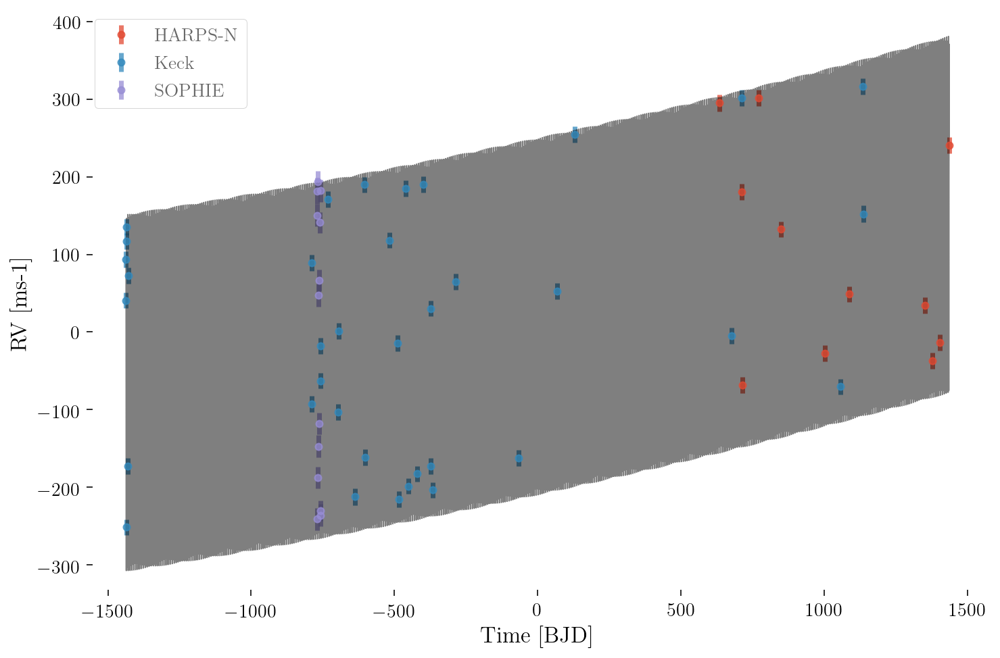

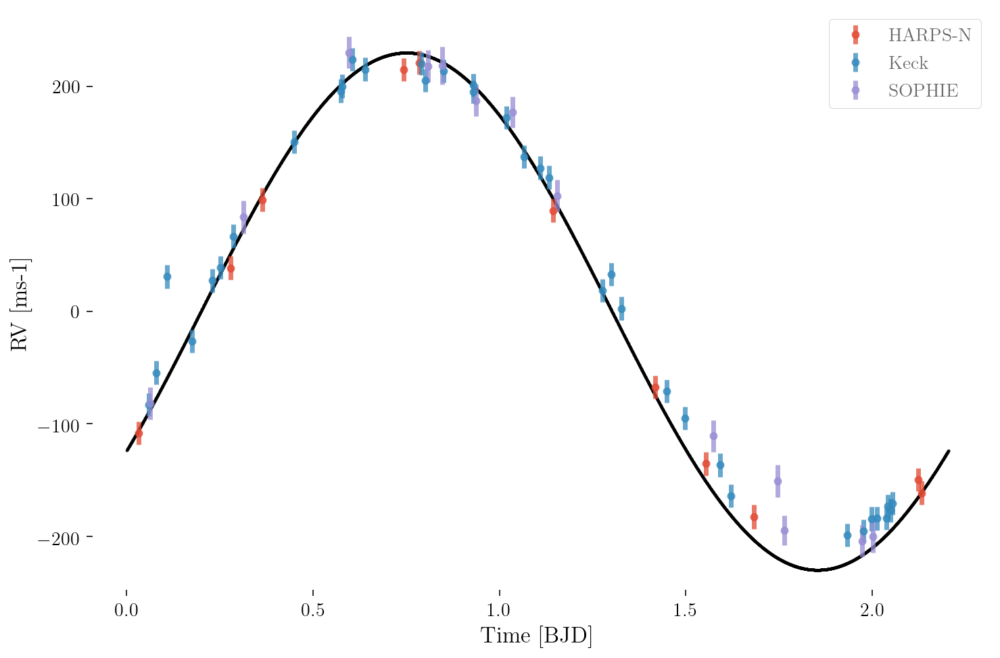

In [668]:
deltaHarps=10500
deltaSophie=10450
jitterHarps=10
jitterSophie=10
jitterKeck=10

t0=0.5*(np.min(rvTs)+np.max(rvTs))+0.1*period #date of middle transit
print('t0: ',t0)
v0=20 #const vel offset
a0=8e-2 #rate of change of vel offset
b0=8e-6 #rate of change of rate of change

v=230
P=period

crvVs=1.0*rvVs
crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)



crvTs=rvTs-t0

mTs=np.linspace(np.min(rvTs),np.max(rvTs),10000)
offsetVel=v0+a0*(mTs-t0)+b0*(mTs-t0)**2
offsetData=v0+a0*(rvTs-t0)+b0*(rvTs-t0)**2

innerVel=v*np.sin(2*np.pi*(t0-mTs)/P)


fullFig=plt.figure(figsize=(12,8))
fullPlot=plt.gca()
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    fullPlot.errorbar(crvTs[thisInst],crvVs[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
fullPlot.plot(mTs-t0,offsetVel+innerVel,c='k',lw=1,alpha=0.5)
fullPlot.set_xlabel('Time [BJD]')
fullPlot.set_ylabel('RV [ms-1]')
plt.legend()
plt.show()


periodFig=plt.figure(figsize=(12,8))
periodPlot=plt.gca()
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    periodPlot.errorbar(rvTs[thisInst]%period,crvVs[thisInst]-offsetData[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
periodPlot.scatter(mTs%period,innerVel,c='k',lw=1,alpha=0.5,s=1)
periodPlot.set_xlabel('Time [BJD]')
periodPlot.set_ylabel('RV [ms-1]')
plt.legend()
plt.show()

In [669]:
def mapXs(x): #maps 0->1 to appropriate parameter values
    newX=np.copy(x)
    if len(newX.shape)==1:
        newX=newX[np.newaxis,:]
    newX[:,0]=0.5*(np.min(rvTs)+np.max(rvTs))+0.06*period+0.08*period*newX[:,0] #t0
    newX[:,1]=-20+80*newX[:,1] #v0
    newX[:,2]=0.05+0.05*newX[:,2] #a0
    newX[:,3]=-1e-5+3e-5*newX[:,3] #b0
    newX[:,4]=0.99995*period+0.0001*period*newX[:,4] #P
    newX[:,5]=180+60*newX[:,5] #v
    newX[:,6]=10450+200*newX[:,6] #deltaHarps
    newX[:,7]=10400+100*newX[:,7] #deltaSophie
    newX[:,8]=40*newX[:,8] # jitterHarps
    newX[:,9]=40*newX[:,9] # jitterSophie
    newX[:,10]=40*newX[:,10] # jitterKeck
    if len(x.shape)==1:
        return newX[0,:]
    return newX

def priors(x):
    if (np.min(x)<0) | (np.max(x)>1):
        return -np.inf
    else:
        return 0.0
    
def lnprob(x,rvTs,rvVs,rvEs,rvIs):
    """The log-likelihood function."""
    prior=priors(x) # all x between 0 and 1
    if prior<0:
        return prior
    x=mapXs(x) # maps them to appropriate parameter values
    
    #preparing the data
    crvVs=1.*rvVs
    deltaHarps=x[6]
    deltaSophie=x[7]
    jitterHarps=x[8]
    jitterSophie=x[9]
    jitterKeck=x[10]
    
    crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
    crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
    crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
    crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
    crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)
    
    t0=x[0]
    v0=x[1]
    a0=x[2]
    b0=x[3]
    P=x[4]
    v=x[5]
    
    modelVs= v0 + a0*(rvTs-t0) + b0*(rvTs-t0)**2 + v*np.sin(2*np.pi*(t0-rvTs)/P)
    deltas=crvVs-modelVs
    residual=np.power(deltas/crvEs,2)
    lnpre=np.log(1/np.sqrt(2*np.pi*crvEs**2))
    return -(np.sum(residual)/2) +np.sum(lnpre) + prior
    #return -(np.sum(residual)/2) + prior

ndim, nwalkers = 11, 512
p0=np.random.rand(ndim * nwalkers).reshape((nwalkers, ndim))

nSteps = 2048
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob,args=[rvTs,rvVs,rvEs,rvIs])
pos, prob, state=sampler.run_mcmc(p0,nSteps)

$t_0 \ [BJD]$
(2455773.413614676, 0.00499440124258399, 0.003915415611118078)
$v_0 \ [ms^{-1}]$
(34.35119128347939, 3.3330262203005603, 4.501718736178212)
$a_0 \ [ms^{-1}day^{-1}]$
(0.08191126988547609, 0.0037859770938176163, 0.0038743117169295765)
$b_0 \ [ms^{-1}day^{-2}]$
(4.928060309401217e-06, 3.0402045173191293e-06, 3.7129880574469675e-06)
$P \ [day]$
(2.2047313990618287, 1.1348733448102166e-05, 8.093632775096893e-06)
$v \ [ms^{-1}]$
(214.01146910010476, 2.29385124011381, 2.2952160298143838)
$\Delta_{HARPS} \ [ms^{-1}]$
(10513.12002831207, 5.751859550808149, 8.101623044114604)
$\Delta_{SOPHIE} \ [ms^{-1}]$
(10444.40946257962, 4.863481636633878, 7.182821884965961)
$\sigma_{HARPS} \ [ms^{-1}]$
(3.5879630873877937, 0.9732294879891783, 5.024845956852966)
$\sigma_{SOPHIE} \ [ms^{-1}]$
(13.263728625419393, 3.398875925628193, 6.296553703559564)
$\sigma_{Keck} \ [ms^{-1}]$
(14.583776362955799, 1.3401656685808803, 3.1586729076291817)


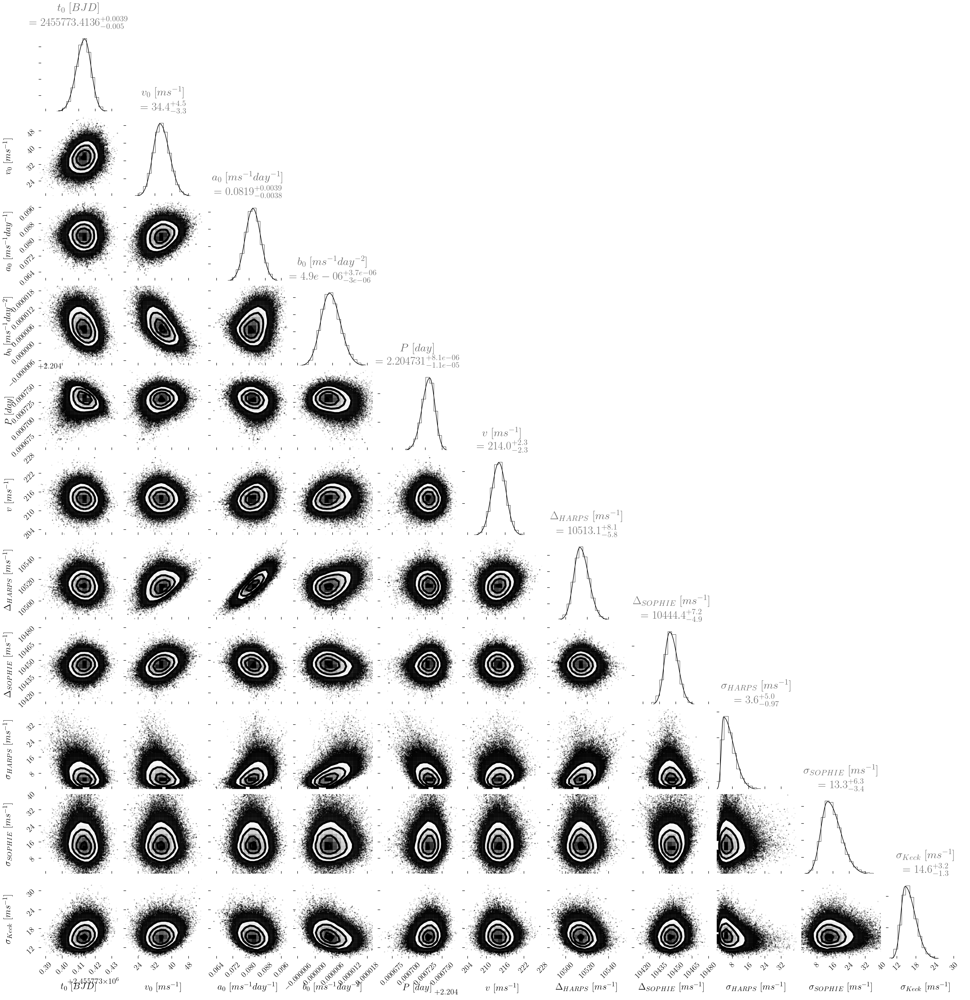

In [670]:
samples = sampler.chain[:,int(nSteps/2):,:].reshape((-1, ndim))
#truths=[np.log10(1.56),np.log10(0.002),np.log10(2),np.log10(0.155),np.log10(0.006),0.2,0,0.5,0,0]
labels=[r'$t_0 \ [BJD]$',r'$v_0 \ [ms^{-1}]$',r'$a_0 \ [ms^{-1}day^{-1}]$',r'$b_0 \ [ms^{-1}day^{-2}]$',r'$P \ [day]$',r'$v \ [ms^{-1}]$',r'$\Delta_{HARPS} \ [ms^{-1}]$',r'$\Delta_{SOPHIE} \ [ms^{-1}]$',r'$\sigma_{HARPS} \ [ms^{-1}]$',r'$\sigma_{SOPHIE} \ [ms^{-1}]$',r'$\sigma_{Keck} \ [ms^{-1}]$']
mapped=mapXs(samples)
for i in range(ndim):
    print(labels[i])
    print(split.fit(mapped[:,i]))
fig = corner.corner(mapped,labels=labels,range=1.0*np.ones(ndim))
axes = np.array(fig.axes).reshape((ndim, ndim))
# Loop over the diagonal
for i in range(ndim):
    mu,sigma,cigma=split.fit(mapped[:,i])
    ax = axes[i, i]
    xlim=ax.get_xlim()
    ylim=ax.get_ylim()
    plotXs=np.linspace(xlim[0],xlim[1],100)
    norm=0.9*ylim[1]/split.splitNormal(np.array([mu]),mu,sigma,cigma)
    ax.plot(plotXs,norm*split.splitNormal(plotXs,mu,sigma,cigma),c='k',lw=1)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    
    
    cigmaString,cigmaDec=sigString(cigma,2,extra=True)
    sigmaString,sigmaDec=sigString(sigma,2,extra=True)
    muSigFigs=np.min([cigmaDec,sigmaDec])
    muString=np.round(mu,muSigFigs)
    if muSigFigs<=0:
        muSigFigs=int(muSigFigs)
    cigmaString = "+{0}".format(cigmaString)
    sigmaString = "-{0}".format(sigmaString)
    titleString = r"{0}".format(labels[i])+"\n = ${"+str(muString)+"}^{"+cigmaString+"}_{"+sigmaString+"}$"
    ax.set_title(titleString)
    
plt.show()

Best log likelihood:  -237.60401781090206
__________ 0
$t_0 \ [BJD]$
2455773.414784802
__________ 1
$v_0 \ [ms^{-1}]$
37.43442678608367
__________ 2
$a_0 \ [ms^{-1}day^{-1}]$
0.08060519134196603
__________ 3
$b_0 \ [ms^{-1}day^{-2}]$
3.0027011683128195e-06
__________ 4
$P \ [day]$
2.2047301129665065
__________ 5
$v \ [ms^{-1}]$
213.4917009226782
__________ 6
$\Delta_{HARPS} \ [ms^{-1}]$
10512.406923314902
__________ 7
$\Delta_{SOPHIE} \ [ms^{-1}]$
10446.49201619592
__________ 8
$\sigma_{HARPS} \ [ms^{-1}]$
3.3421155679154637
__________ 9
$\sigma_{SOPHIE} \ [ms^{-1}]$
11.71310995989524
__________ 10
$\sigma_{Keck} \ [ms^{-1}]$
15.81971489454723


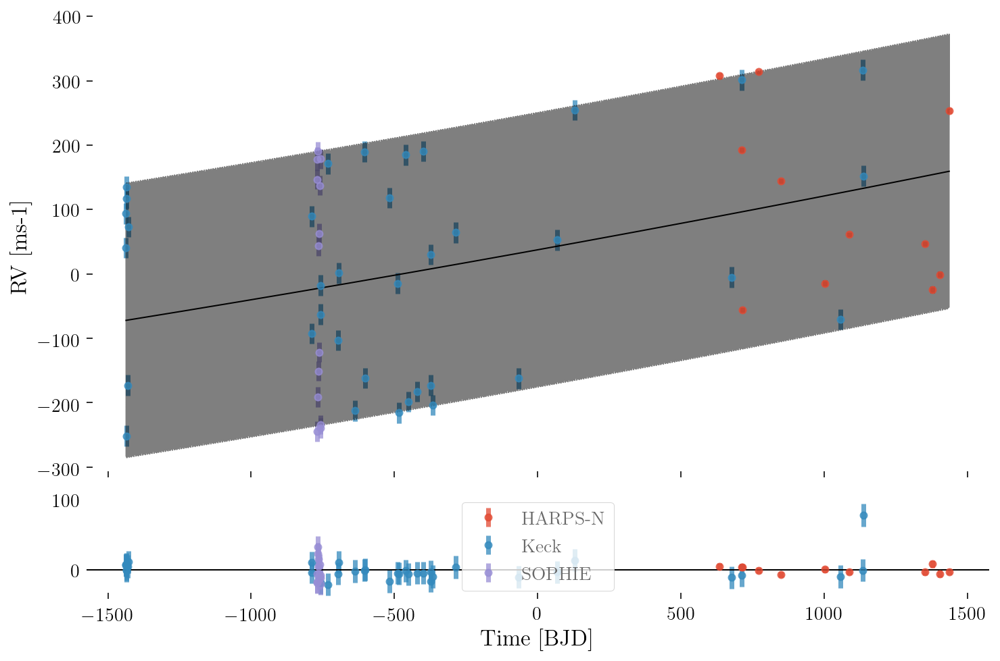

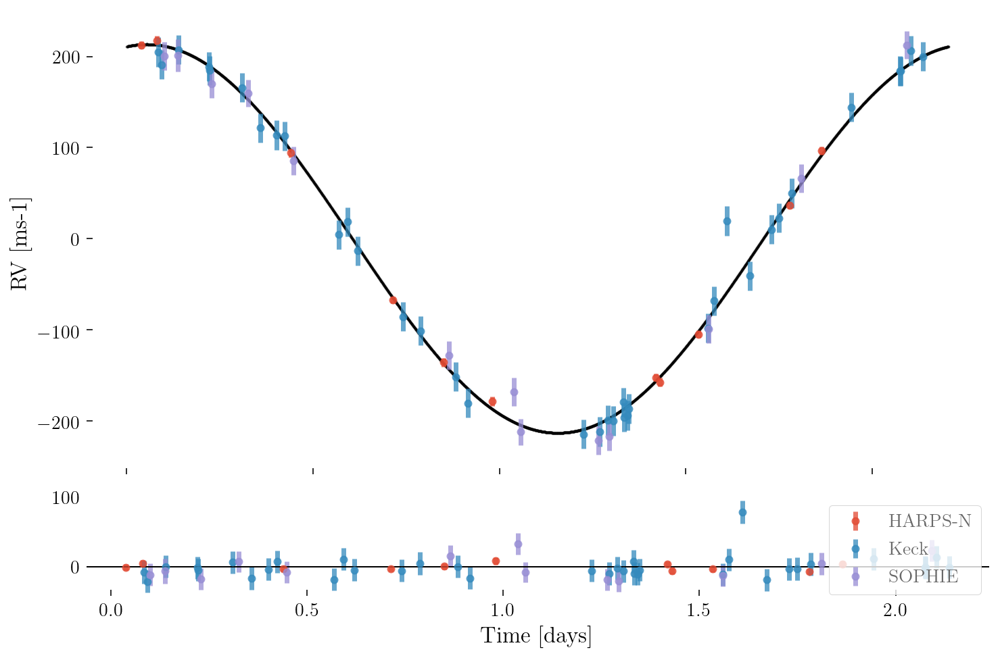

In [671]:
bestProb=np.max(sampler.lnprobability)
bestStep=np.argmax(sampler.lnprobability)
bestX=sampler.chain.reshape((-1, ndim))[bestStep,:]

print('Best log likelihood: ',np.max(prob))
x=mapXs(bestX)
for i in range(x.size):
    print('__________',i)
    print(labels[i])
    print(x[i])

crvVs=1.0*rvVs
deltaHarps=x[6]
deltaSophie=x[7]
jitterHarps=x[8]
jitterSophie=x[9]
jitterKeck=x[10]
crvVs[rvIs=='HARPS-N']=rvVs[rvIs=='HARPS-N']+deltaHarps
crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
crvEs[rvIs=='HARPS-N']=np.sqrt(rvEs[rvIs=='HARPS-N']**2 + jitterHarps**2)
crvEs[rvIs=='SOPHIE']=np.sqrt(rvEs[rvIs=='SOPHIE']**2 + jitterSophie**2)
crvEs[rvIs=='Keck']=np.sqrt(rvEs[rvIs=='Keck']**2 + jitterKeck**2)
    
t0=x[0]
v0=x[1]
a0=x[2]
b0=x[3]
P=x[4]
v=x[5]
    
crvTs=rvTs-t0

mTs=np.linspace(np.min(rvTs),np.max(rvTs),16000)
offsetVel=v0+a0*(mTs-t0)+b0*(mTs-t0)**2
offsetData=v0+a0*(rvTs-t0)+b0*(rvTs-t0)**2

innerVel=v*np.sin(2*np.pi*(t0-mTs)/P)
innerData=v*np.sin(2*np.pi*(t0-rvTs)/P)


fullFig=plt.figure(figsize=(12,8))
fullGrid=mpl.gridspec.GridSpec(5,1)
fullPlot=plt.subplot(fullGrid[:4,0])
fullRes=plt.subplot(fullGrid[4,0])
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    residual=(crvVs-innerData-offsetData)[thisInst]
    fullPlot.errorbar(crvTs[thisInst],crvVs[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
    fullRes.errorbar(crvTs[thisInst],residual,yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
fullPlot.set_xticklabels([])
plt.legend()
fullPlot.plot(mTs-t0,offsetVel+innerVel,c='k',lw=1,alpha=0.5)
fullPlot.plot(mTs-t0,offsetVel,c='k',lw=1)
fullRes.set_xlabel('Time [BJD]')
fullPlot.set_ylabel('RV [ms-1]')
fullRes.axhline(0,c='k',lw=1)
plt.show()


periodFig=plt.figure(figsize=(12,8))
periodGrid=mpl.gridspec.GridSpec(5,1)
periodPlot=plt.subplot(periodGrid[:4,0])
periodRes=plt.subplot(periodGrid[4,0])
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    residual=(crvVs-innerData-offsetData)[thisInst]
    periodPlot.errorbar(rvTs[thisInst]%P,crvVs[thisInst]-offsetData[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
    periodRes.errorbar(rvTs[thisInst]%P,residual,yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
periodPlot.set_xticklabels([])
plt.legend()
periodRes.axhline(0,c='k',lw=1)
periodPlot.scatter(mTs%P,innerVel,c='k',lw=1,alpha=0.1,s=1)
periodRes.set_xlabel('Time [days]')
periodPlot.set_ylabel('RV [ms-1]')
plt.show()

# Alt fit

In [428]:
def mapXs(x): #maps 0->1 to appropriate parameter values
    newX=np.copy(x)
    if len(newX.shape)==1:
        newX=newX[np.newaxis,:]
    newX[:,0]=-10500+1000*newX[:,0] #v0
    newX[:,1]=300+300*newX[:,1] #v1
    newX[:,2]=100+200*newX[:,2] #v2
    newX[:,3]=5000+45000*newX[:,3] #P1
    newX[:,4]=0.9995*period+0.001*period*newX[:,4] #P2
    newX[:,5]=newX[:,5] #pi1
    newX[:,6]=0.2*newX[:,6] #pi2
    newX[:,7]=-10500+20*newX[:,7] #deltaKeck
    newX[:,8]=-60+20*newX[:,8] #deltaSophie
    #newX[:,9]=10*newX[:,9] #jitter
    if len(x.shape)==1:
        return newX[0,:]
    return newX

def priors(x):
    if (np.min(x)<0) | (np.max(x)>1):
        return -np.inf
    else:
        return 0.0
    
def lnprob(x,rvTs,rvVs,rvEs,rvIs):
    """The log-likelihood function."""
    prior=priors(x) # all x between 0 and 1
    if prior<0:
        return prior
    x=mapXs(x) # maps them to appropriate parameter values
    
    #preparing the data
    crvVs=1.*rvVs
    deltaKeck=x[7]
    deltaSophie=x[8]
    #jitter=x[9]
    crvVs[rvIs=='Keck']=rvVs[rvIs=='Keck']+deltaKeck
    crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
    #crvEs=np.sqrt(rvEs**2 + jitter**2)
    crvEs=rvEs
    
    v0=x[0]
    v1=x[1]
    v2=x[2]
    P1=x[3]
    P2=x[4]
    pi1=x[5]*P1
    pi2=x[6]*P2
    
    modelVs= v0 + v1*np.sin(2*np.pi*(rvTs-pi1)/P1) + v2*np.sin(2*np.pi*(rvTs-pi2)/P2)
    deltas=crvVs-modelVs
    residual=np.power(deltas/crvEs,2)
    lnpre=np.log(1/np.sqrt(2*np.pi*crvEs))
    #return -(np.sum(residual)/2) +np.sum(lnpre) + prior
    return -(np.sum(residual)/2) + prior

ndim, nwalkers = 9, 256
p0=np.random.rand(ndim * nwalkers).reshape((nwalkers, ndim))

nSteps = 2048
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob,args=[rvTs,rvVs,rvEs,rvIs])
pos, prob, state=sampler.run_mcmc(p0,nSteps)

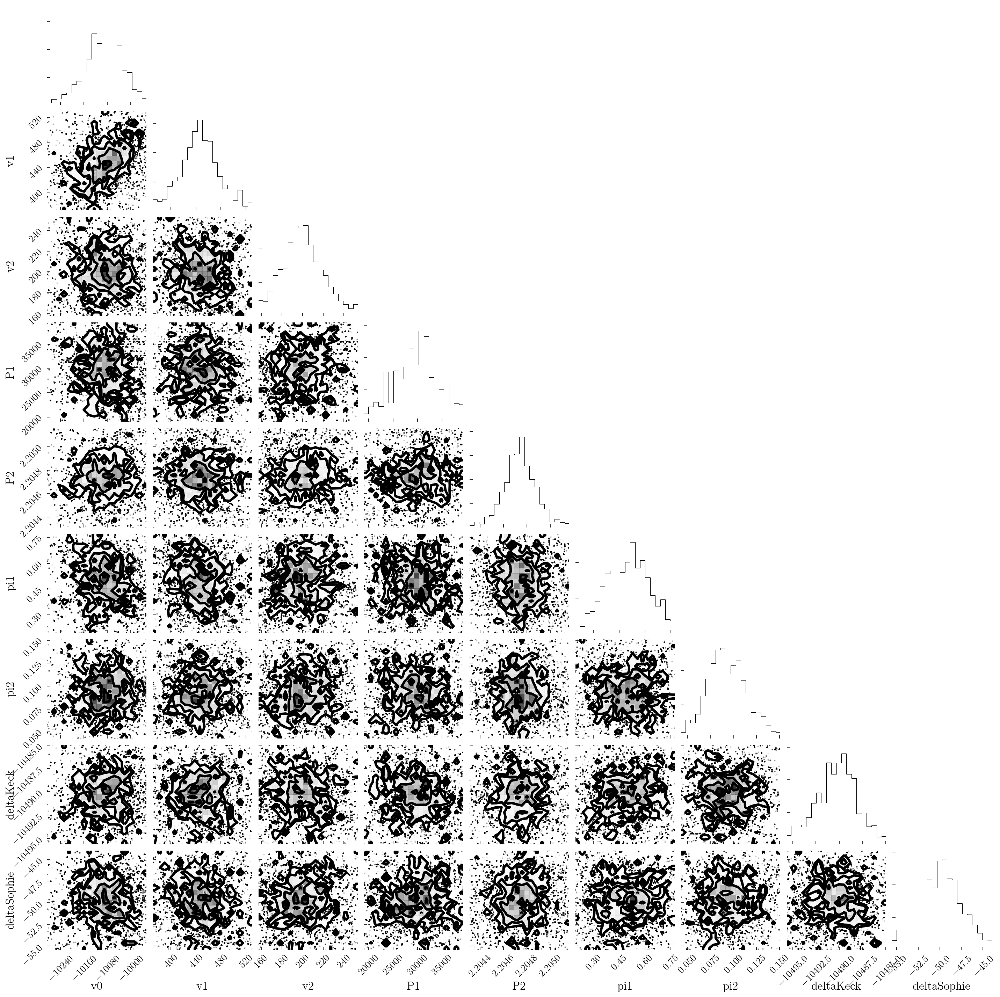

In [429]:
samples = sampler.chain.reshape((-1, ndim))
#truths=[np.log10(1.56),np.log10(0.002),np.log10(2),np.log10(0.155),np.log10(0.006),0.2,0,0.5,0,0]
labels=['v0','v1','v2','P1','P2','pi1','pi2','deltaKeck','deltaSophie']
mapped=mapXs(samples)
fig = corner.corner(mapped,labels=labels,range=0.95*np.ones(ndim))
plt.show()

__________ 0
v0
-10145.098387752145
__________ 1
v1
439.452972538862
__________ 2
v2
206.19307667718908
__________ 3
P1
26005.788992876267
__________ 4
P2
2.2047255519596343
__________ 5
pi1
0.5646173188881554
__________ 6
pi2
0.07429213364811237
__________ 7
deltaKeck
-10490.434063777788
__________ 8
deltaSophie
-50.37180499916458


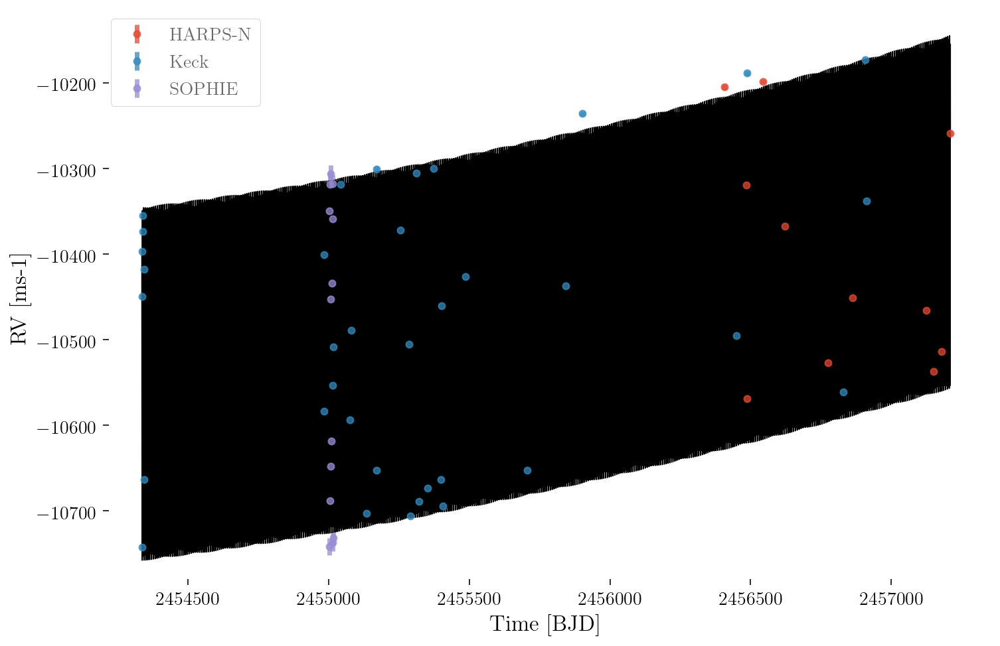

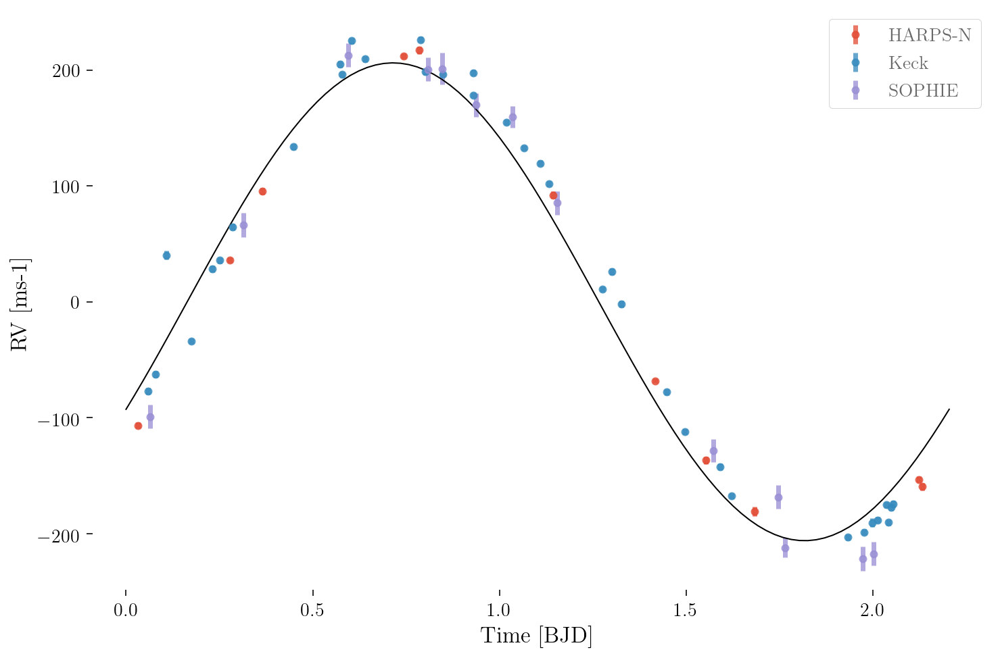

In [430]:
bestX=pos[np.argsort(prob)[-1],:]
x=mapXs(bestX)
for i in range(x.size):
    print('__________',i)
    print(labels[i])
    print(x[i])

crvVs=1.0*rvVs
deltaKeck=x[7]
deltaSophie=x[8]
#jitter=x[9]
crvVs[rvIs=='Keck']=rvVs[rvIs=='Keck']+deltaKeck
crvVs[rvIs=='SOPHIE']=rvVs[rvIs=='SOPHIE']+deltaSophie
#crvEs=np.sqrt(rvEs**2 + jitter**2)
crvEs=rvEs
    
v0=x[0]
v1=x[1]
v2=x[2]
P1=x[3]
P2=x[4]
pi1=x[5]*P1
pi2=x[6]*P2

modelTs=np.linspace(np.min(rvTs),np.max(rvTs),10000)
modelVs= v0 + v1*np.sin(2*np.pi*(modelTs-pi1)/P1) + v2*np.sin(2*np.pi*(modelTs-pi2)/P2)

fullFig=plt.figure(figsize=(12,8))
fullPlot=plt.gca()
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    fullPlot.errorbar(rvTs[thisInst],crvVs[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
fullPlot.plot(modelTs,modelVs,c='k',lw=1)
fullPlot.set_xlabel('Time [BJD]')
fullPlot.set_ylabel('RV [ms-1]')
plt.legend()
plt.show()

ccrvVs=crvVs-(v0 + v1*np.sin(2*np.pi*(rvTs-pi1)/P1))
cmodelTs=np.linspace(0,period,100)
cmodelVs=v2*np.sin(2*np.pi*(cmodelTs-pi2)/P2)

perFig=plt.figure(figsize=(12,8))
perPlot=plt.gca()
for name in np.unique(rvIs):
    thisInst=np.flatnonzero(rvIs==name)
    perPlot.errorbar(rvTs[thisInst]%period,ccrvVs[thisInst],yerr=crvEs[thisInst],markersize=5,alpha=0.75,label=name,fmt='o')
perPlot.plot(cmodelTs,cmodelVs,c='k',lw=1)
perPlot.set_xlabel('Time [BJD]')
perPlot.set_ylabel('RV [ms-1]')
plt.legend()
plt.show()


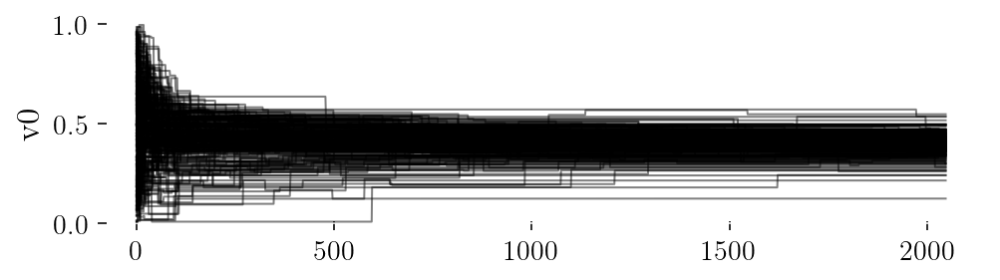

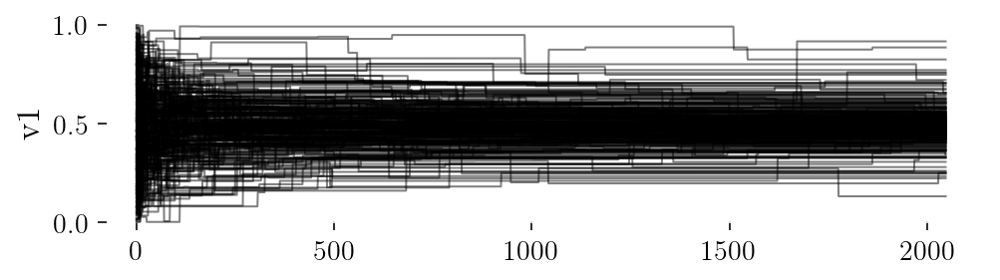

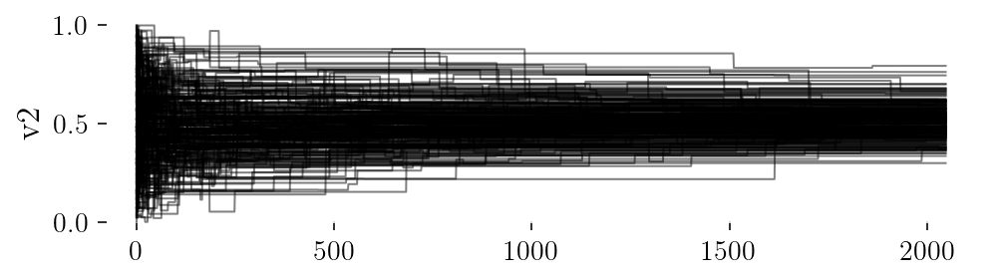

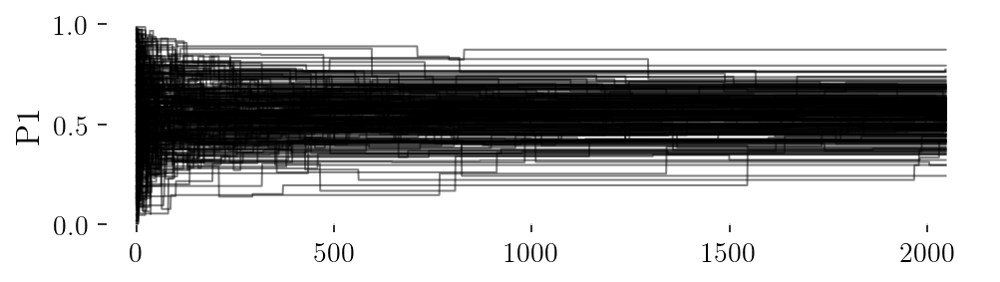

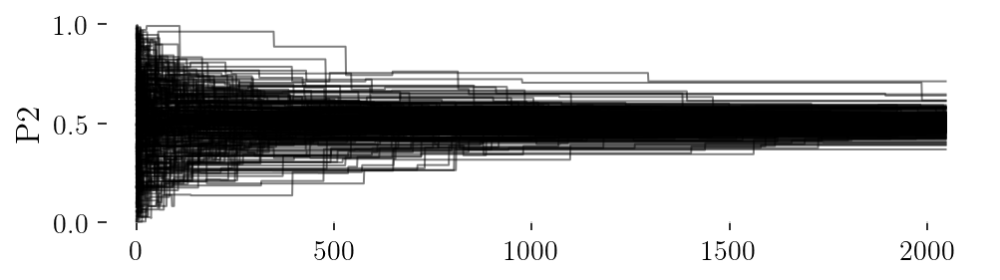

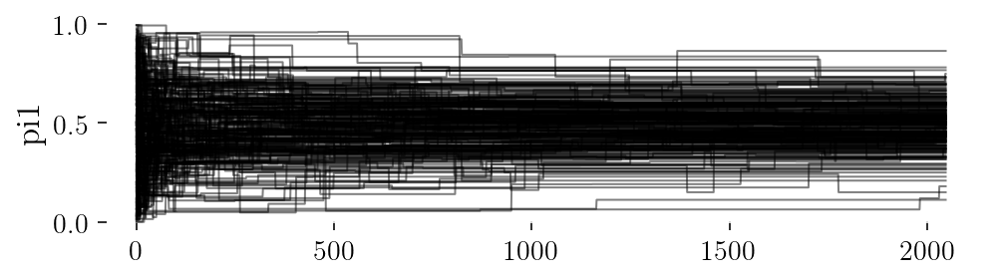

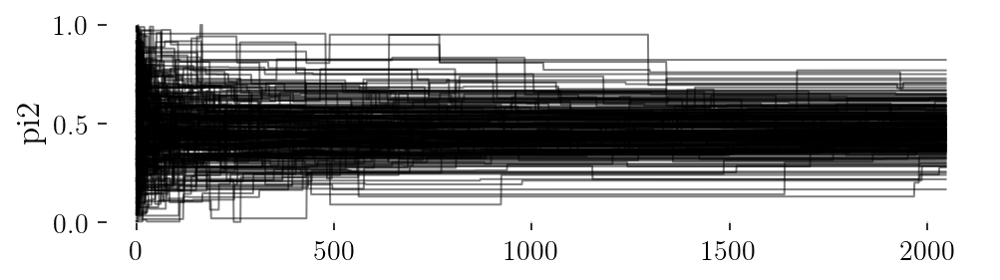

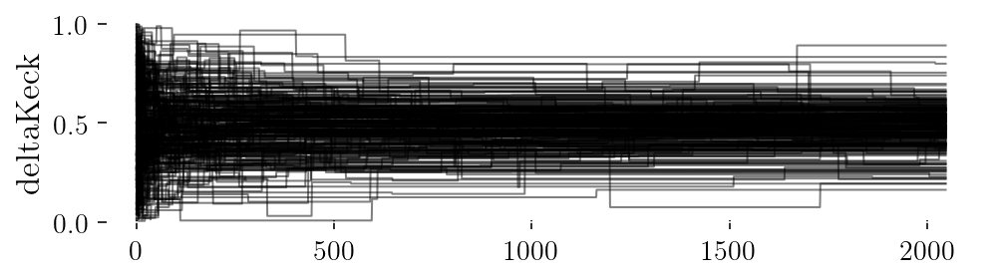

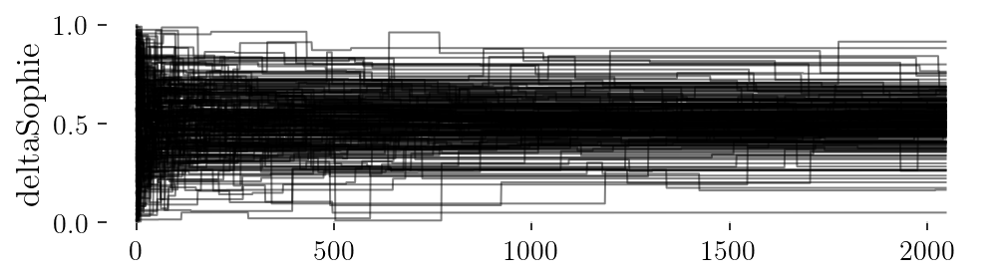

In [431]:
for i in range(ndim):
    fig = plt.figure(figsize=(8,2))
    thisPlot=plt.gca()
    for j in range(nwalkers):
        thisPlot.plot(sampler.chain[j,:,i],lw=1,c='k',alpha=0.5)
    thisPlot.set_ylabel(labels[i])
    plt.show()

In [221]:
print(deltaKeck)

-10431.428205594872


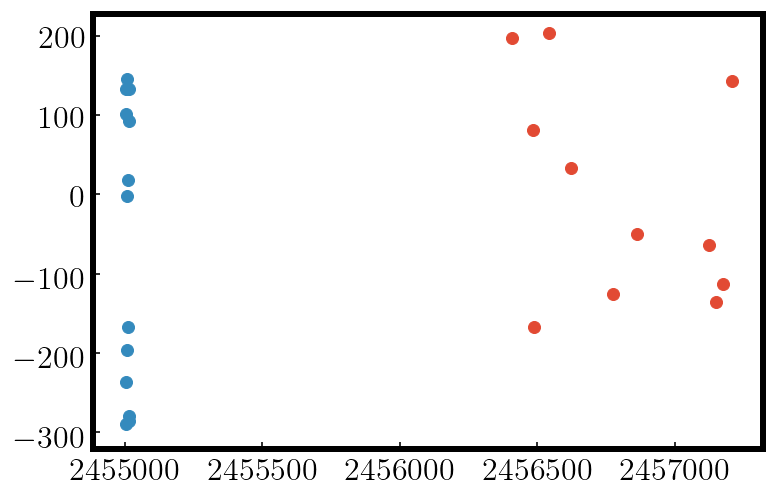

In [135]:
plt.scatter(rvTs3,rvVs3)
plt.scatter(rvTs4,rvVs4)
plt.show()

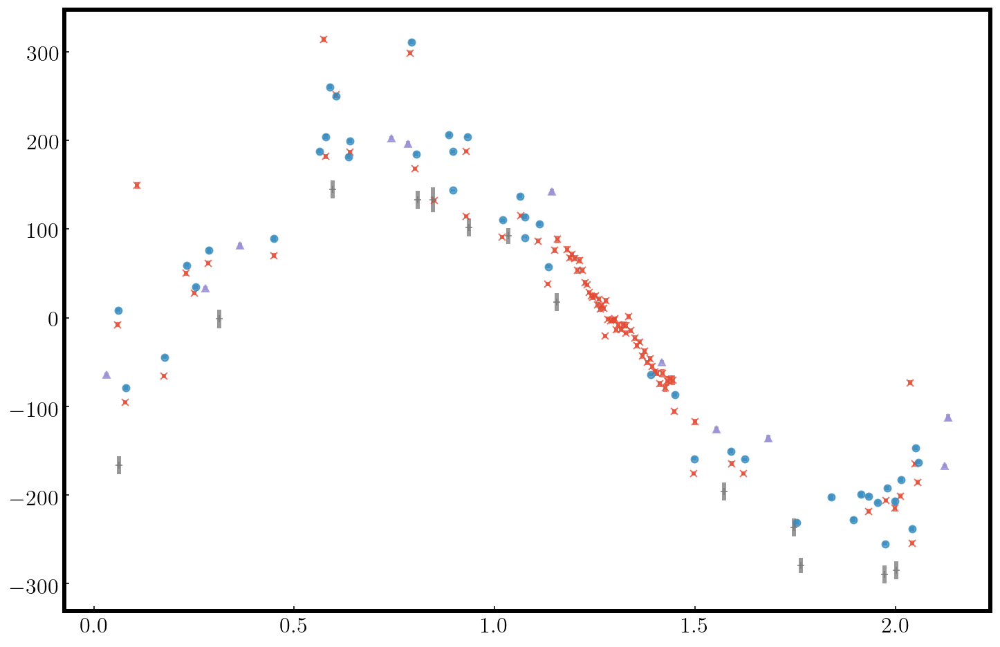

In [130]:
rvFig=plt.figure(figsize=(12,8))
rvPlot=plt.gca()
rvPlot.errorbar(rvTs%period,rvVs,yerr=rvEs,fmt='x',markersize=5,alpha=0.75)
rvPlot.errorbar(rvTs2%period,rvVs2,yerr=rvEs2,fmt='o',markersize=5,alpha=0.75)
rvPlot.errorbar(rvTs3%period,rvVs3,yerr=rvEs3,fmt='^',markersize=5,alpha=0.75)
rvPlot.errorbar(rvTs4%period,rvVs4,yerr=rvEs4,fmt='+',markersize=5,alpha=0.75)

plt.show()

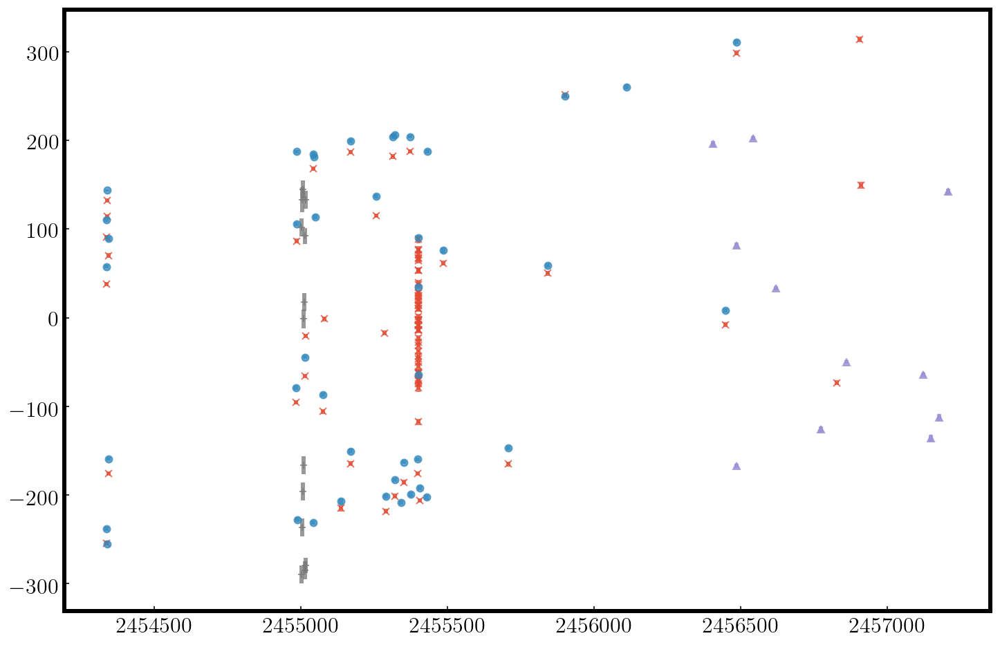

In [131]:
rvFig=plt.figure(figsize=(12,8))
rvPlot=plt.gca()
rvPlot.errorbar(rvTs,rvVs,yerr=rvEs,fmt='x',markersize=5,alpha=0.75)
rvPlot.errorbar(rvTs2,rvVs2,yerr=rvEs2,fmt='o',markersize=5,alpha=0.75)
rvPlot.errorbar(rvTs3,rvVs3,yerr=rvEs3,fmt='^',markersize=5,alpha=0.75)
rvPlot.errorbar(rvTs4,rvVs4,yerr=rvEs4,fmt='+',markersize=5,alpha=0.75)

plt.show()

In [5]:
#import importlib
#importlib.reload(pydata)


In [34]:
import emcee
import batman

planet=oot.planet()
planet.M=1.56
planet.R=2.0
planet.Mp=0.002
planet.Rp=0.155

planet.e=0.006
planet.Ag=0.2
planet.a=planet.a*np.power(period/oot.findPeriod(planet),2/3)
print('a: ',planet.a)
tTransit=0
planet.vPhi=0.5*np.pi
planet.vTheta=83*np.pi/180
planet.tp=planet.tp+(tTransit-oot.findTransit(planet))

nTs=600
modelTs=np.linspace(-period/2,period/2,nTs)
modelFs=1+oot.deltaSum(modelTs,planet)

transit=1
if transit==1:
    t0,per,rp,a,inc,ecc,w=oot.batman(planet)
    params = batman.TransitParams()
    params.t0 = t0                       #time of inferior conjunction
    params.per = per                      #orbital period
    params.rp = rp                     #planet radius (in units of stellar radii)
    params.a = a                       #semi-major axis (in units of stellar radii)
    params.inc = inc                     #orbital inclination (in degrees)
    params.ecc = ecc                      #eccentricity
    params.w = w                       #longitude of periastron (in degrees)
    params.u = [0.6]                #limb darkening coefficients
    params.limb_dark = "linear"       #limb darkening model

    m = batman.TransitModel(params, modelTs)
    batmanModel=m.light_curve(params)
    modelFs=modelFs*batmanModel
norm=np.median(modelFs)
modelFs=(modelFs/norm)-1
    #fs=deltas-np.max(deltas)
modelEs=0.1*np.ones_like(modelFs)*np.median(np.abs(modelFs))


a:  8.271231707463656


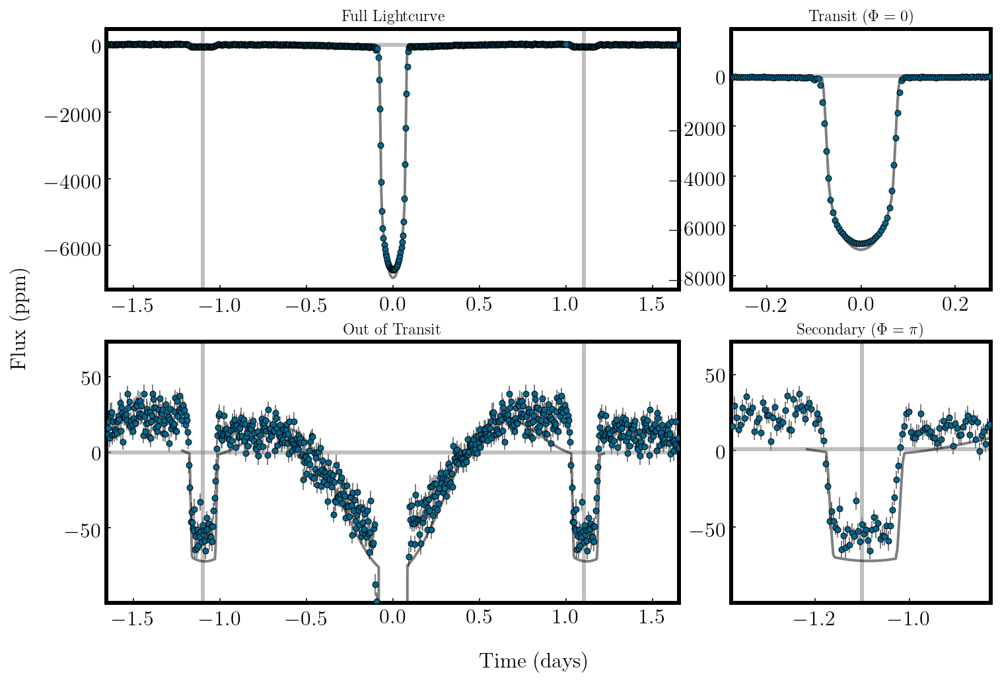

In [35]:
thisFig,thisGrid=pyplot.makeFig()
pyplot.plotData(thisGrid,ts,fs,es,period=period)
pyplot.plotModel(thisGrid,modelTs,modelFs,period=period)

In [36]:
def translateParams(planet,x):
    planet.M=10**x[0]
    planet.Mp=10**x[1]
    planet.R=10**x[2]
    planet.Rp=10**x[3]
    planet.e=10**x[4]
    planet.Ag=x[5]
    tTransit=x[6]

    #planet.tp=tTransit-oot.findTransit(planet)
    planet.a=planet.a*np.power(period/oot.findPeriod(planet),2/3) # For a known period, a is a dependant variable
    
    b=x[7]
    planet.vTheta=np.arccos(b*planet.R/planet.a)
    planet.vPhi=x[8]
    
    planet.tp=planet.tp+(tTransit-oot.findTransit(planet))
    
    return planet

def mapXs(x): #maps 0->1 to appropriate parameter values
    newX=np.copy(x)
    if len(newX.shape)==1:
        newX=newX[np.newaxis,:]
    newX[:,0]=-1+2*newX[:,0] #log(M)
    newX[:,1]=-3.5+3*newX[:,1] #log(Mp)
    newX[:,2]=-1.5+3*newX[:,2] #log(R)
    newX[:,3]=-2+2*newX[:,3] #log(Rp)
    newX[:,4]=-3+3*newX[:,4] #log(e)
    newX[:,5]=0.5*newX[:,5] #Ag
    newX[:,6]=(-0.5+newX[:,6])*period # tTransit
    newX[:,7]=newX[:,7] # b
    newX[:,8]=2*np.pi*newX[:,8] # vPhi
    newX[:,9]=(-0.5+newX[:,9])*2e-4 # offset
    if len(x.shape)==1:
        return newX[0,:]
    return newX

def priors(x):
    if (np.min(x)<0) | (np.max(x)>1):
        return -np.inf
    else:
        return 0.0
    
def lnprob(x,ts,fs,es,planet):
    """The log-likelihood function."""
    prior=priors(x) # all x between 0 and 1
    if prior<0:
        return prior
    x=mapXs(x) # maps them to appropriate parameter values
    planet=translateParams(planet,x)
    if (planet.R<planet.Rp) | (planet.R>planet.a):
        return -np.inf #at the moment oot breaks if R<Rp - should investigate
    
    ootFs=1+oot.deltaSum(ts,planet,secondary=1)
    
    transit=oot.checkTransit(planet)
    if transit==1:
        t0,per,rp,a,inc,ecc,w=oot.batman(planet)
        params = batman.TransitParams()
        params.t0 = t0                       #time of inferior conjunction
        params.per = per                      #orbital period
        params.rp = rp                     #planet radius (in units of stellar radii)
        params.a = a                       #semi-major axis (in units of stellar radii)
        params.inc = inc                     #orbital inclination (in degrees)
        params.ecc = ecc                      #eccentricity
        params.w = w                       #longitude of periastron (in degrees)
        params.u = [0.6]                #limb darkening coefficients
        params.limb_dark = "linear"       #limb darkening model

        m = batman.TransitModel(params, ts)
        batmanModel=m.light_curve(params)
        modelFs=ootFs*batmanModel
    else:
        modelFs=ootFs
    
    norm=np.median(modelFs)
    deltas=(modelFs/norm)-1
    deltas=deltas+x[9]
    #deltas=deltas-np.max(deltas)
    
    residual=np.power((deltas-fs)/es,2)
    return -(np.sum(residual)/2) + prior

ndim, nwalkers = 10, 128
p0=np.random.rand(ndim * nwalkers).reshape((nwalkers, ndim))

nSteps = 1024
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob,args=[ts,fs,es,planet])
pos, prob, state=sampler.run_mcmc(p0,nSteps)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in arccos
  


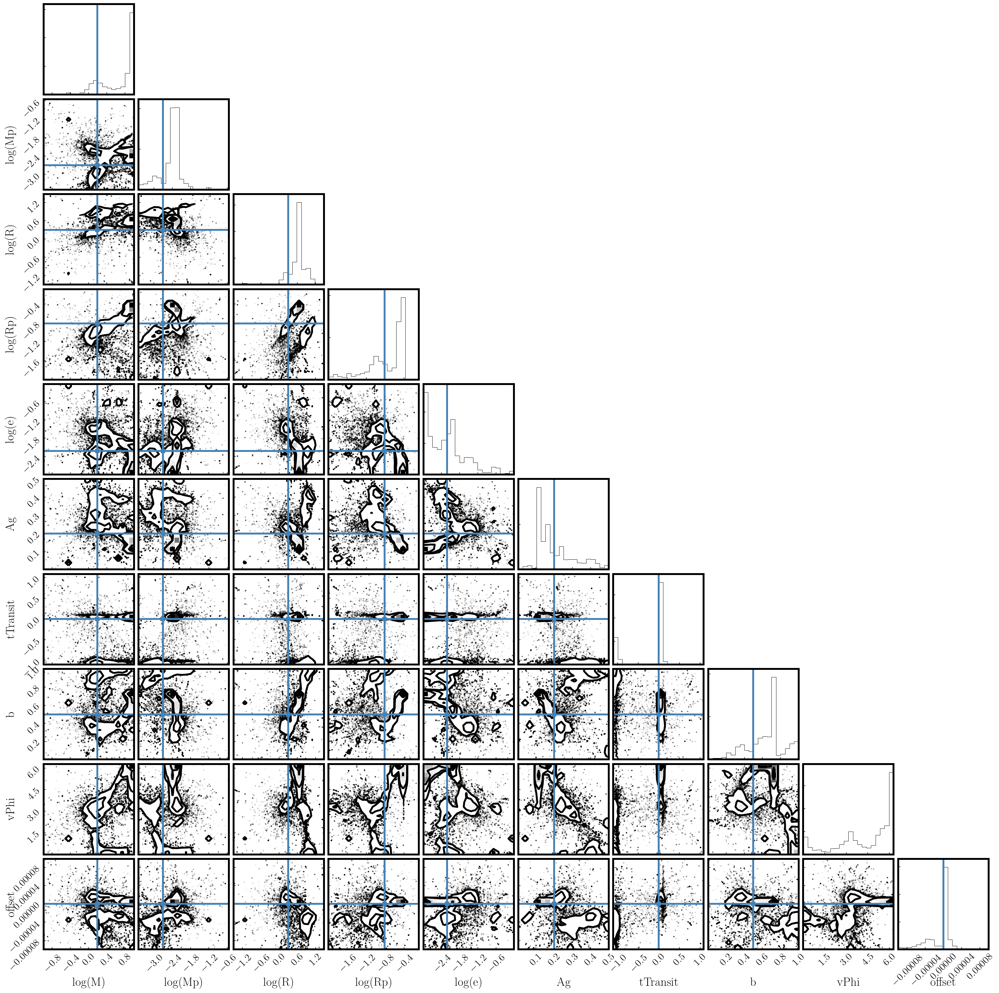

In [37]:
import corner
samples = sampler.chain.reshape((-1, ndim))
truths=[np.log10(1.56),np.log10(0.002),np.log10(2),np.log10(0.155),np.log10(0.006),0.2,0,0.5,0,0]
mapped=mapXs(samples)
fig = corner.corner(mapped,labels=['log(M)','log(Mp)','log(R)','log(Rp)','log(e)','Ag','tTransit','b','vPhi','offset'],truths=truths)
plt.show()

In [38]:
bestX=pos[np.argsort(prob)[-1],:]
print(mapXs(bestX))
planet=translateParams(planet,mapXs(bestX))
planet.a=planet.a*np.power(period/oot.findPeriod(planet),2/3)

nTs=600
modelTs=np.linspace(-period/2,period/2,nTs)
#modelTs=np.hstack([modelTs[:500],modelTs[600:]])
ootFs=1+oot.deltaSum(modelTs,planet)#,secondary=1)

transit=oot.checkTransit(planet)
if transit==1:
    t0,per,rp,a,inc,ecc,w=oot.batman(planet)
    params = batman.TransitParams()
    params.t0 = t0                       #time of inferior conjunction
    params.per = per                      #orbital period
    params.rp = rp                     #planet radius (in units of stellar radii)
    params.a = a                       #semi-major axis (in units of stellar radii)
    params.inc = inc                     #orbital inclination (in degrees)
    params.ecc = ecc                      #eccentricity
    params.w = w                       #longitude of periastron (in degrees)
    params.u = [0.6]                #limb darkening coefficients
    params.limb_dark = "linear"       #limb darkening model

    m = batman.TransitModel(params, modelTs)
    batmanModel=m.light_curve(params)
    modelFs=ootFs*batmanModel
    norm=np.median(modelFs)
    
deltas=(modelFs/norm)-1
deltas=deltas+mapXs(bestX)[9]

#deltas=deltas-np.max(deltas)

[ 9.97857240e-01 -2.40313596e+00  6.76079714e-01 -4.11031357e-01
 -2.97291893e+00  1.14218834e-01  9.82329573e-02  7.39419861e-01
  6.21978129e+00  1.97429278e-06]


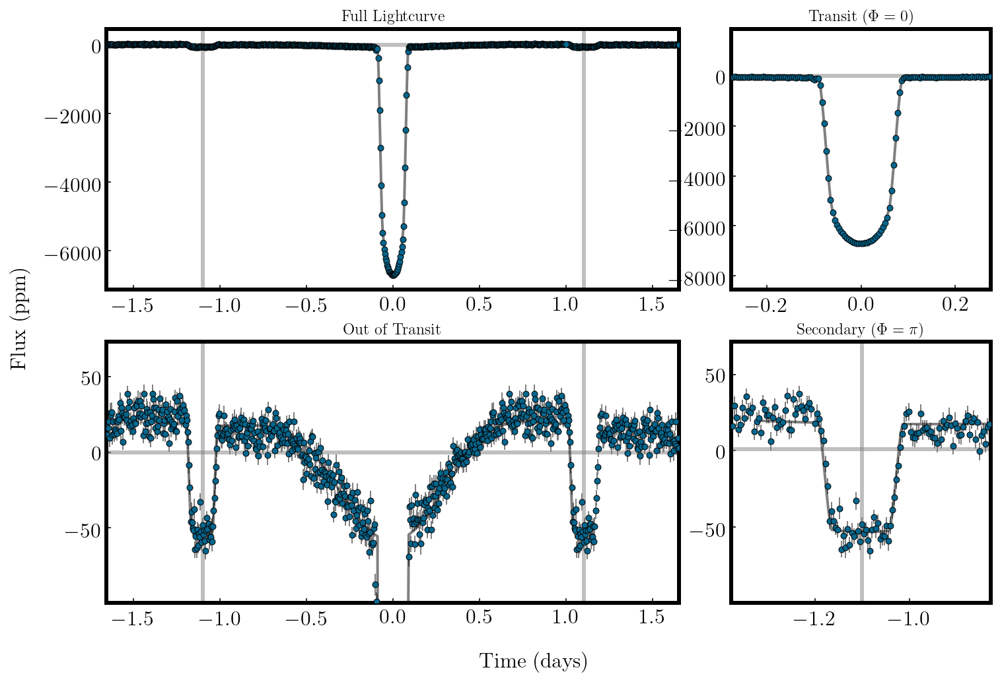

In [39]:
thisFig,thisGrid=pyplot.makeFig()
offset=pyplot.plotData(thisGrid,ts,fs,es,period=kep2.period)
pyplot.plotModel(thisGrid,modelTs,deltas,period=kep2.period,offset=offset)
plt.show()

a:  8.271231707463656
51
32


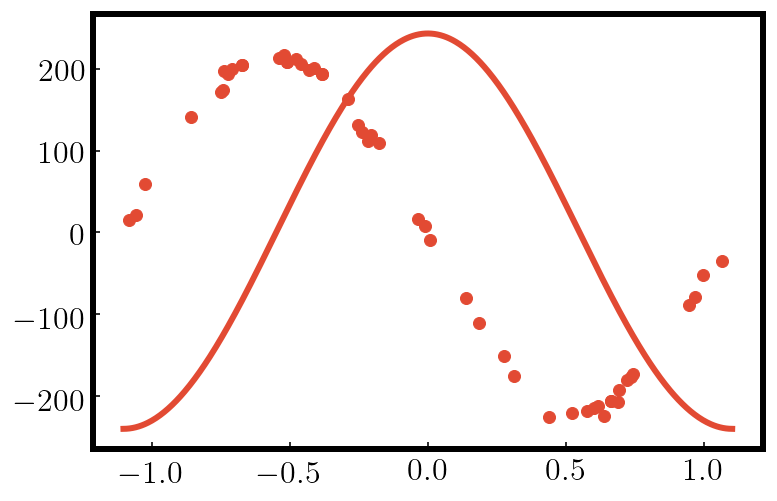

In [40]:
import astropy.io
planet=oot.planet()
planet.M=1.56
planet.R=2.0
planet.Mp=0.002
planet.Rp=0.155

planet.e=0.006
planet.Ag=0.2
planet.a=planet.a*np.power(period/oot.findPeriod(planet),2/3)
print('a: ',planet.a)
tTransit=0
planet.vPhi=0.5*np.pi
planet.vTheta=83*np.pi/180

data=astropy.io.ascii.read('hat-p-7b.csv')
rTs=data['x']*period # in days
rVs=data['rvs'] # in ms-1
rEs=np.array([5,15,15,15,8,10,15,12,5,5,10,12,10,10,15,15,8,5,5,5,10,12,12,5,5,15,10,8,15,20,5,10])
print(rVs.size)
print(rEs.size)
thisPlot=plt.gca()
thisPlot.scatter(rTs,rVs)
modelRvs=oot.vOrbit(modelTs,planet)#*695508000/(24*60*2)
thisPlot.plot(modelTs,modelRvs)
plt.show()

In [41]:
def rvParams(planet,x):
    planet.M=10**x[0]
    planet.Mp=10**x[1]
    planet.R=10**x[2]
    planet.e=10**x[3]
    tTransit=x[4]

    #planet.tp=tTransit-oot.findTransit(planet)
    planet.a=planet.a*np.power(period/oot.findPeriod(planet),2/3) # For a known period, a is a dependant variable
    
    b=x[5]
    planet.vTheta=np.arccos(b*planet.R/planet.a)
    planet.vPhi=x[6]
    
    planet.tp=planet.tp+(tTransit-oot.findTransit(planet))
    return planet

def mapRvs(x): #maps 0->1 to appropriate parameter values
    newX=np.copy(x)
    if len(newX.shape)==1:
        newX=newX[np.newaxis,:]
    newX[:,0]=-1+2*newX[:,0] #log(M)
    newX[:,1]=-3.5+3*newX[:,1] #log(Mp)
    newX[:,2]=-1.5+3*newX[:,2] #log(R)
    newX[:,3]=-3+3*newX[:,3] #log(e)
    newX[:,4]=(-0.5+newX[:,4])*period # tTransit
    newX[:,5]=newX[:,5] # b
    newX[:,6]=2*np.pi*newX[:,6] # vPhi
    if len(x.shape)==1:
        return newX[0,:]
    return newX

def priors(x):
    if (np.min(x)<0) | (np.max(x)>1):
        return -np.inf
    else:
        return 0.0
    
def rvprob(x,ts,rvs,rEs,planet):
    """The log-likelihood function."""
    prior=priors(x) # all x between 0 and 1
    if prior<0:
        return prior
    x=mapRvs(x) # maps them to appropriate parameter values
    planet=rvParams(planet,x)
    if (planet.R>planet.a):
        return -np.inf #at the moment oot breaks if R<Rp - should investigate
    
    ootRvs=oot.vOrbit(ts,planet)
    
    residual=np.power((ootRvs-rvs)/rEs,2)
    return -(np.sum(residual)/2) + prior

ndim, nwalkers = 7, 64
p0=np.random.rand(ndim * nwalkers).reshape((nwalkers, ndim))

nSteps = 512
sampler = emcee.EnsembleSampler(nwalkers, ndim, rvprob,args=[rTs,rVs,10*np.ones_like(rVs),planet])
pos, prob, state=sampler.run_mcmc(p0,nSteps)

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in arccos
  if sys.path[0] == '':


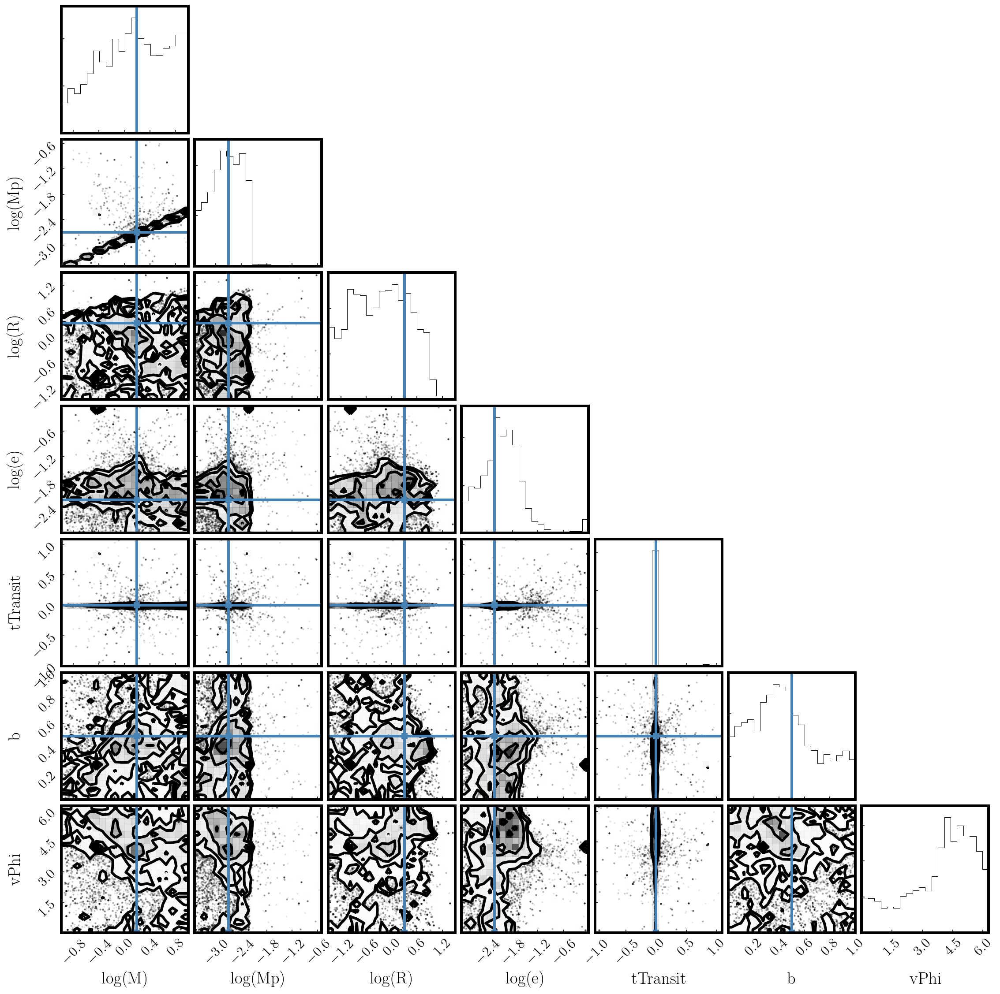

In [42]:
samples = sampler.chain.reshape((-1, ndim))
truths=[np.log10(1.56),np.log10(0.002),np.log10(2),np.log10(0.006),0,0.5,0,0]
mapped=mapRvs(samples)
fig = corner.corner(mapped,labels=['log(M)','log(Mp)','log(R)','log(e)','tTransit','b','vPhi','offset'],truths=truths)
plt.show()

[ 9.76533879e-01 -2.22824615e+00 -3.91567481e-01 -2.52770254e+00
 -4.42226281e-03  2.99159321e-01  5.61206557e+00]


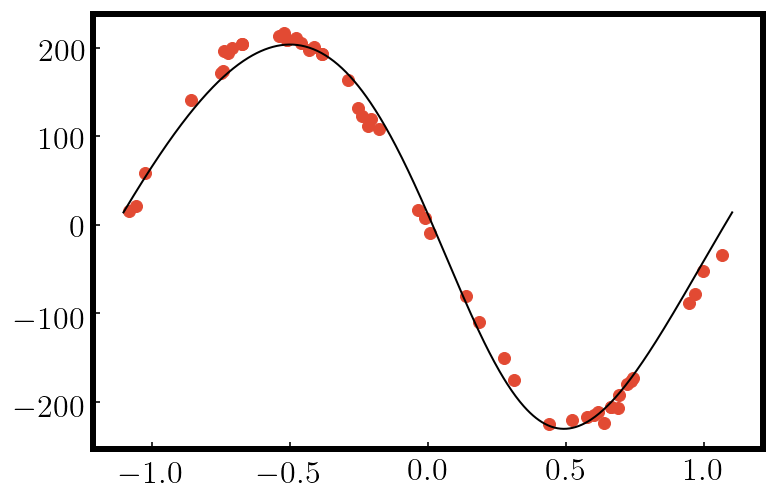

In [43]:
bestX=pos[np.argmax(prob),:]
print(mapRvs(bestX))
planet=rvParams(planet,mapRvs(bestX))
planet.a=planet.a*np.power(period/oot.findPeriod(planet),2/3)
planet.e=0.1
nTs=600
modelTs=np.linspace(-period/2,period/2,nTs)

thisPlot=plt.gca()
thisPlot.scatter(rTs,rVs)
modelRvs=oot.vOrbit(modelTs,planet)#*695508000/(24*60*2)
thisPlot.plot(modelTs,modelRvs,c='k',lw=1)
plt.show()

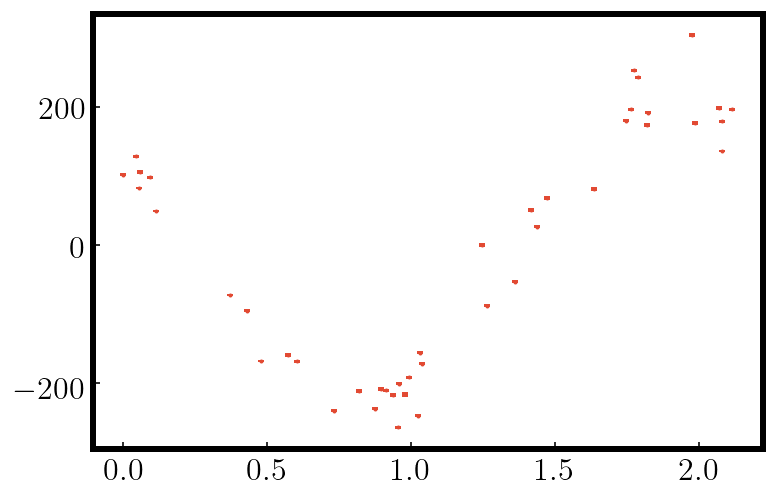

In [188]:
rvData=astropy.io.ascii.read('hatP7b-RVs.tsv')
rvTsStr=rvData['BJD']
rvTsStr=rvTsStr[2:]
rvTs=np.zeros(len(rvTsStr))
for i in range(len(rvTsStr)):
    rvTs[i]=float(rvTsStr[i])-float(rvTsStr[0])

rvVsStr=rvData['RV']
rvVs=np.zeros(rvTs.size)
rvVsStr=rvVsStr[2:]
for i in range(rvTs.size):
    rvVs[i]=float(rvVsStr[i])
rvEsStr=rvData['e_RV']
rvEs=np.zeros(rvTs.size)
rvEsStr=rvEsStr[2:]
for i in range(rvTs.size):
    rvEs[i]=float(rvEsStr[i])

plot=plt.gca()
plot.errorbar(rvTs%period,rvVs, yerr=rvEs,fmt='o',markersize=1)
plt.show()

In [191]:
print(rvTsStr[-1])
print(rvVs)
print(rvEs)

2456486.1276152
[ 1.01670e+02  4.91030e+01 -2.47028e+02  1.35287e+02 -2.63723e+02
 -1.67728e+02  8.07270e+01 -8.77210e+01  9.74850e+01  1.78990e+02
 -2.36554e+02 -5.29320e+01  1.76423e+02 -2.39906e+02  1.73432e+02
  1.05268e+02 -9.52740e+01 -2.15848e+02  1.91148e+02 -1.59091e+02
  1.28376e+02 -2.10119e+02  1.95927e+02 -1.91599e+02  1.97803e+02
 -2.16910e+02 -1.71556e+02  1.96091e+02 -2.08173e+02 -1.68217e+02
  2.61360e+01  8.19620e+01 -7.26780e+01 -2.00678e+02 -2.11121e+02
  1.79527e+02  6.77290e+01 -1.55741e+02  5.05640e+01  2.42076e+02
  2.52248e+02 -2.55000e-01  3.02939e+02]
[2.159 1.934 2.193 1.416 2.138 2.057 2.57  2.569 2.256 2.242 2.674 2.161
 2.423 2.31  2.42  2.648 2.168 3.428 2.468 2.553 2.229 2.333 2.657 2.34
 2.341 2.414 2.2   2.239 2.545 1.946 2.288 1.201 1.537 2.272 2.819 2.373
 2.768 2.302 2.697 2.551 2.539 2.556 2.65 ]


In [160]:
def translateParams(planet,x):
    planet.M=10**x[0]
    planet.Mp=10**x[1]
    planet.R=10**x[2]
    planet.Rp=10**x[3]
    planet.e=10**x[4]
    planet.Ag=x[5]
    tTransit=x[6]

    #planet.tp=tTransit-oot.findTransit(planet)
    planet.a=planet.a*np.power(period/oot.findPeriod(planet),2/3) # For a known period, a is a dependant variable
    #print(planet.a)
    
    b=x[7]
    planet.vTheta=np.arccos(b*planet.R/planet.a)
    planet.vPhi=x[8]
    
    planet.tp=planet.tp+(tTransit-oot.findTransit(planet))
    
    return planet

def mapXs(x): #maps 0->1 to appropriate parameter values
    newX=np.copy(x)
    if len(newX.shape)==1:
        newX=newX[np.newaxis,:]
    newX[:,0]=-0.5+1*newX[:,0] #log(M)
    newX[:,1]=-3.5+3*newX[:,1] #log(Mp)
    newX[:,2]=-1.5+3*newX[:,2] #log(R)
    newX[:,3]=-2+2*newX[:,3] #log(Rp)
    newX[:,4]=-4+4*newX[:,4] #log(e)
    newX[:,5]=0.5*newX[:,5] #Ag
    newX[:,6]=(-0.1+0.2*newX[:,6])*period # tTransit
    newX[:,7]=newX[:,7] # b
    newX[:,8]=2*np.pi*newX[:,8] # vPhi
    newX[:,9]=(-0.5+newX[:,9])*2e-4 # offset
    newX[:,10]=(newX[:,10])*period # tRvOffset
    if len(x.shape)==1:
        return newX[0,:]
    return newX

derivedRhos=[]

def priors(x):
    if (np.min(x)<0) | (np.max(x)>1):
        return -np.inf
    else:
        M=10**(-0.5+1*x[0])
        R=10**(-1.5+3*x[2])
        rhoLit=  0.2712*np.power(6.957e10,3)/2e33
        rhoEs= 0.0032*np.power(6.957e10,3)/2e33
        rho=3*M/(4*np.pi*R**3)
        derivedRhos.append(rho/rhoLit)
        return -np.power((rho-rhoLit)/rhoEs,2) + np.log(np.sqrt(2*np.pi*rhoEs**2))
    
def lnprob(x,ts,fs,es,rTs,rVs,rEs,planet):
    """The log-likelihood function."""
    prior=priors(x) # all x between 0 and 1
    if ~np.isfinite(prior):
        return prior
    x=mapXs(x) # maps them to appropriate parameter values
    planet=translateParams(planet,x)
    if (planet.R<planet.Rp) | (planet.R>planet.a):
        return -np.inf #at the moment oot breaks if R<Rp - should investigate
    
    ootFs=1+oot.deltaSum(ts,planet,secondary=1)
    
    transit=oot.checkTransit(planet)
    if transit==1:
        t0,per,rp,a,inc,ecc,w=oot.batman(planet)
        params = batman.TransitParams()
        params.t0 = t0                       #time of inferior conjunction
        params.per = per                      #orbital period
        params.rp = rp                     #planet radius (in units of stellar radii)
        params.a = a                       #semi-major axis (in units of stellar radii)
        params.inc = inc                     #orbital inclination (in degrees)
        params.ecc = ecc                      #eccentricity
        params.w = w                       #longitude of periastron (in degrees)
        params.u = [0.6]                #limb darkening coefficients
        params.limb_dark = "linear"       #limb darkening model

        m = batman.TransitModel(params, ts)
        batmanModel=m.light_curve(params)
        modelFs=ootFs*batmanModel
    else:
        modelFs=ootFs
    
    norm=np.median(modelFs)
    deltas=(modelFs/norm)-1
    deltas=deltas+x[9]
    #deltas=deltas-np.max(deltas)
    
    residual=np.power((deltas-fs)/es,2)
    
    rvTs=((rTs+x[10])%period)-(period/2)
    ootRvs=oot.vSum(rvTs,planet)
    rvResidual=np.power((ootRvs-rVs)/rEs,2)
    
    return -(np.sum(residual)/2) -(np.sum(rvResidual)/2) + prior
    #return -(np.sum(residual)/2)  + prior

ndim, nwalkers = 11, 256
p0=np.random.rand(ndim * nwalkers).reshape((nwalkers, ndim))

nSteps = 1024
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob,args=[ts,fs,es,rTs,rVs,5*np.ones_like(rVs),planet])
pos, prob, state=sampler.run_mcmc(p0,nSteps)

/Users/zephyrpenoyre/Google Drive/astro/pythonModules/OoT_fix/oot.py:161: RuntimeWarning: invalid value encountered in arccos
  firstTerm=((rUnit*pl.Rp)**2)*np.arccos((d**2 + (rUnit*pl.Rp)**2 - pl.R**2)/(2*d*(rUnit*pl.Rp)))
/Users/zephyrpenoyre/Google Drive/astro/pythonModules/OoT_fix/oot.py:162: RuntimeWarning: invalid value encountered in arccos
  secondTerm=(pl.R**2)*np.arccos((d**2 + pl.R**2 - (rUnit*pl.Rp)**2)/(2*d*pl.R))
/Users/zephyrpenoyre/Google Drive/astro/pythonModules/OoT_fix/oot.py:163: RuntimeWarning: invalid value encountered in sqrt
  thirdTerm=-0.5*np.sqrt((d+(rUnit*pl.Rp)+pl.R)*(d+(rUnit*pl.Rp)-pl.R)*(d+pl.R-(rUnit*pl.Rp))*(-d+pl.R+(rUnit*pl.Rp)))
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in arccos
  from ipykernel import kernelapp as app
/anaconda3/lib/python3.7/site-packages/emcee/ensemble.py:335: RuntimeWarning: invalid value encountered in subtract
  lnpdiff = (self.dim - 1.) * np.log(zz) + newlnprob

emcee: Exception while calling your likelihood function:
  params: [0.62282946 0.24494246 0.69097039 0.18132489 0.32347569 0.53643739
 0.03152837 0.26942276 0.28561113 0.24185488 0.39711692]
  args: [array([-1.10021884e+00, -1.09592011e+00, -1.09162138e+00, -1.08732265e+00,
       -1.08302392e+00, -1.07872519e+00, -1.07442646e+00, -1.07012773e+00,
       -1.06582900e+00, -1.06153027e+00, -1.05723154e+00, -1.05293282e+00,
       -1.04863409e+00, -1.04433536e+00, -1.04003663e+00, -1.03573790e+00,
       -1.03143917e+00, -1.02714044e+00, -1.02284171e+00, -1.01854298e+00,
       -1.01424425e+00, -1.00994552e+00, -1.00564679e+00, -1.00134806e+00,
       -9.97049327e-01, -9.92750597e-01, -9.88451867e-01, -9.84153137e-01,
       -9.79854408e-01, -9.75555678e-01, -9.71256948e-01, -9.66958218e-01,
       -9.62659488e-01, -9.58360758e-01, -9.54062028e-01, -9.49763299e-01,
       -9.45464569e-01, -9.41165839e-01, -9.36867109e-01, -9.32568379e-01,
       -9.28269649e-01, -9.23970919e-01, -9.196721

Traceback (most recent call last):
  File "/anaconda3/lib/python3.7/site-packages/emcee/ensemble.py", line 519, in __call__
    return self.f(x, *self.args, **self.kwargs)
  File "<ipython-input-160-e775bdf237cb>", line 95, in lnprob
    ootRvs=oot.vSum(rvTs,planet)
  File "/Users/zephyrpenoyre/Google Drive/astro/pythonModules/OoT_fix/oot.py", line 117, in vSum
    return vOrbit(t,pl)+vTide(t,pl)
  File "/Users/zephyrpenoyre/Google Drive/astro/pythonModules/OoT_fix/oot.py", line 112, in vOrbit
    return np.sqrt(G*pl.M/((aUnit*pl.a)*(1-pl.e**2)))*((mUnit*pl.Mp)/pl.M)*np.sin(pl.vTheta)*(np.sin(psi)+pl.e*np.sin(pl.vPhi))*(Rsun/day) # in ms-1
  File "/anaconda3/lib/python3.7/site-packages/astropy/table/column.py", line 382, in __array_wrap__
    out_arr = super().__array_wrap__(out_arr, context)
  File "/anaconda3/lib/python3.7/site-packages/numpy/ma/core.py", line 3034, in __array_wrap__
    result = obj.view(type(self))
  File "/anaconda3/lib/python3.7/site-packages/numpy/ma/core.py", l

KeyboardInterrupt: 

In [ ]:
import corner
import splitnormal.splitnormal as split
samples = sampler.chain.reshape((-1, ndim))
truths=[np.log10( 1.5),np.log10(1.776e-3),np.log10( 1.84),np.log10(0.136),np.log10(0.0016),0.2,0,0.5,np.pi,0,0]
labels=['log(M)','log(Mp)','log(R)','log(Rp)','log(e)','Ag','tTransit','b','vPhi','offset','rvTimeOffset']
mapped=mapXs(samples[int(nwalkers*nSteps/2):,:])
print(mapped.shape)
for i in range(ndim):
    lab=labels[i]
    if (labels[i])[:3]=='log':
        print(lab[4:-1])
        print(split.fit(10**mapped[:,i]))
    else:
        print(lab)
        print(split.fit(mapped[:,i]))
fig = corner.corner(mapped,labels=labels,truths=truths,range=0.95*np.ones_like(truths))
plt.show()

[ 4.97488632e-01 -2.55302227e+00  4.25101304e-01 -6.88336108e-01
 -3.36311038e+00  1.86402742e-01  9.80947815e-02  5.34083562e-01
  3.25863574e-01  6.86176562e-06  1.20686988e+00]
[0.17609125905568124, -2.750557038557418, 0.2648178230095365, -0.8664610916297825, -2.795880017344075, 0.2, 0, 0.5, 0, 0, 0]
[3.14404412e+00 2.79883781e-03 2.66134578e+00 2.04957536e-01
 4.33400707e-04 1.53604076e+00 1.25341469e+00 3.42045249e+00
 2.11769579e+00 1.00001580e+00 1.61016314e+01]


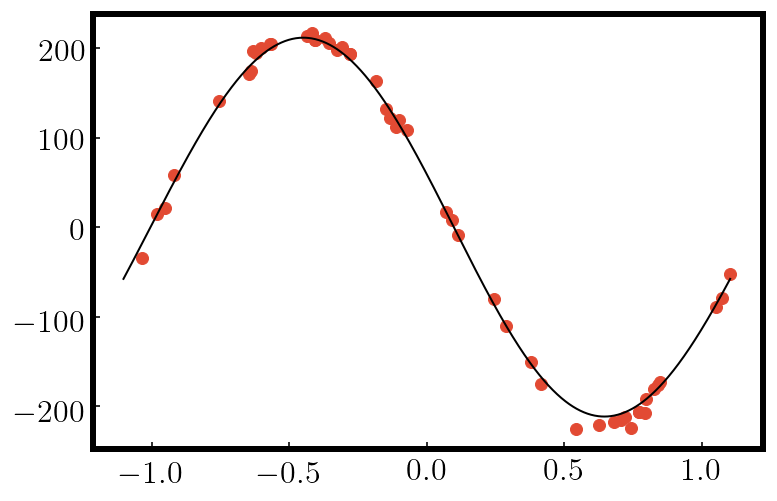

/Users/zephyrpenoyre/Google Drive/astro/pythonModules/OoT_fix/oot.py:161: RuntimeWarning: invalid value encountered in arccos
  firstTerm=((rUnit*pl.Rp)**2)*np.arccos((d**2 + (rUnit*pl.Rp)**2 - pl.R**2)/(2*d*(rUnit*pl.Rp)))
/Users/zephyrpenoyre/Google Drive/astro/pythonModules/OoT_fix/oot.py:162: RuntimeWarning: invalid value encountered in arccos
  secondTerm=(pl.R**2)*np.arccos((d**2 + pl.R**2 - (rUnit*pl.Rp)**2)/(2*d*pl.R))
/Users/zephyrpenoyre/Google Drive/astro/pythonModules/OoT_fix/oot.py:163: RuntimeWarning: invalid value encountered in sqrt
  thirdTerm=-0.5*np.sqrt((d+(rUnit*pl.Rp)+pl.R)*(d+(rUnit*pl.Rp)-pl.R)*(d+pl.R-(rUnit*pl.Rp))*(-d+pl.R+(rUnit*pl.Rp)))
/anaconda3/lib/python3.7/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future 

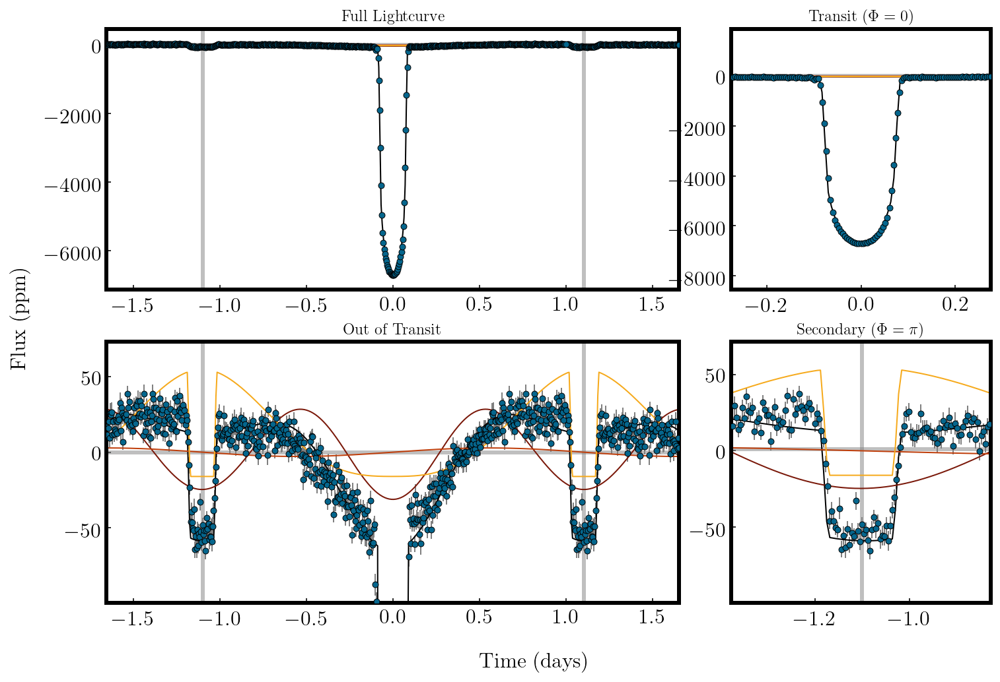

In [148]:
bestX=pos[np.argsort(prob)[-1],:]
print(mapXs(bestX))
print(truths)
print(10**(mapXs(bestX)))
planet=translateParams(planet,mapXs(bestX))
planet.a=planet.a*np.power(period/oot.findPeriod(planet),2/3)

nTs=1000
modelTs=np.linspace(-period/2,period/2,nTs)
rvTs=((rTs+mapXs(bestX)[10])%period)-(period/2)

thisPlot=plt.gca()
thisPlot.scatter(rvTs,rVs)
modelRvs=oot.vSum(modelTs,planet)#*695508000/(24*60*2)
thisPlot.plot(modelTs,modelRvs,c='k',lw=1)
plt.show()


modelTs=np.linspace(-3*period/2,3*period/2,nTs)

ootFs=1+oot.deltaSum(modelTs,planet)#,secondary=1)
ootFts=1+oot.deltaTide(modelTs,planet)
ootFbs=1+oot.deltaBeam(modelTs,planet)
ootFrs=1+oot.deltaReflect(modelTs,planet)

transit=oot.checkTransit(planet)
if transit==1:
    t0,per,rp,a,inc,ecc,w=oot.batman(planet)
    params = batman.TransitParams()
    params.t0 = t0                       #time of inferior conjunction
    params.per = per                      #orbital period
    params.rp = rp                     #planet radius (in units of stellar radii)
    params.a = a                       #semi-major axis (in units of stellar radii)
    params.inc = inc                     #orbital inclination (in degrees)
    params.ecc = ecc                      #eccentricity
    params.w = w                       #longitude of periastron (in degrees)
    params.u = [0.6]                #limb darkening coefficients
    params.limb_dark = "linear"       #limb darkening model

    m = batman.TransitModel(params, modelTs)
    batmanModel=m.light_curve(params)
    modelFs=ootFs*batmanModel
    norm=np.median(modelFs)
    
deltas=(modelFs/norm)-1
deltaTs=(ootFts/np.median(ootFts))-1#+mapXs(bestX)[9]
deltaRs=(ootFrs/np.median(ootFrs))-1#+mapXs(bestX)[9]
deltaBs=(ootFbs/np.median(ootFbs))-1#+mapXs(bestX)[9]
deltas=deltas+mapXs(bestX)[9]

tColour='#7A1809'
bColour='#BF3E0B'
rColour='#F6AA1C'

thisFig,thisGrid=pyplot.makeFig()
offset=pyplot.plotData(thisGrid,ts,fs,es,period=period)
pyplot.plotModel(thisGrid,modelTs,deltas,period=period,offset=offset,alpha=1,c='k',lw=1)
pyplot.plotModel(thisGrid,modelTs,deltaTs,period=period,offset=offset,c=tColour,lw=1,alpha=1)
pyplot.plotModel(thisGrid,modelTs,deltaBs,period=period,offset=offset,c=bColour,lw=1,alpha=1)
pyplot.plotModel(thisGrid,modelTs,deltaRs,period=period,offset=offset,c=rColour,lw=1,alpha=1)

plt.savefig('plots/hatP7b.pdf')
plt.show()

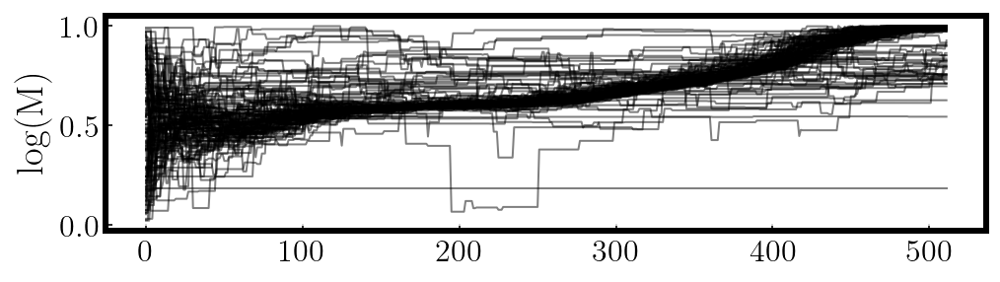

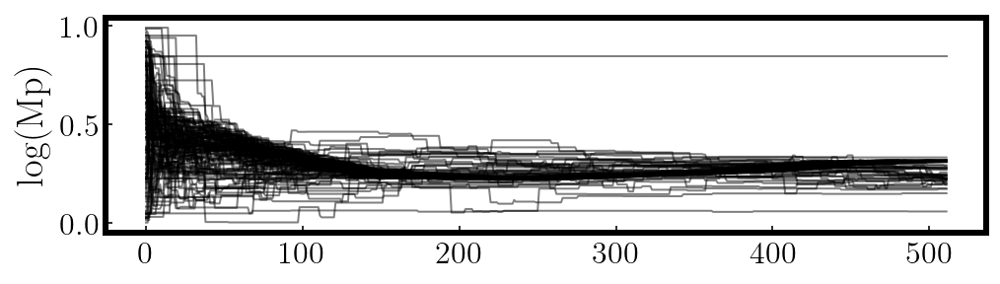

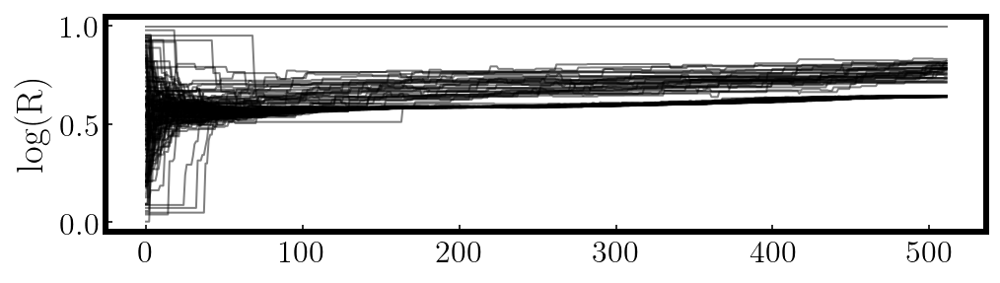

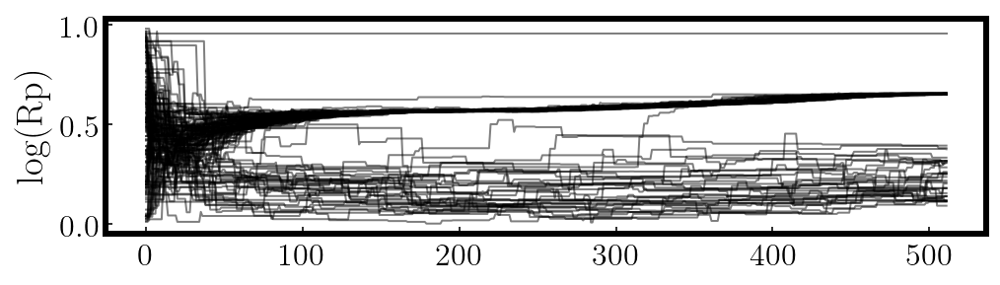

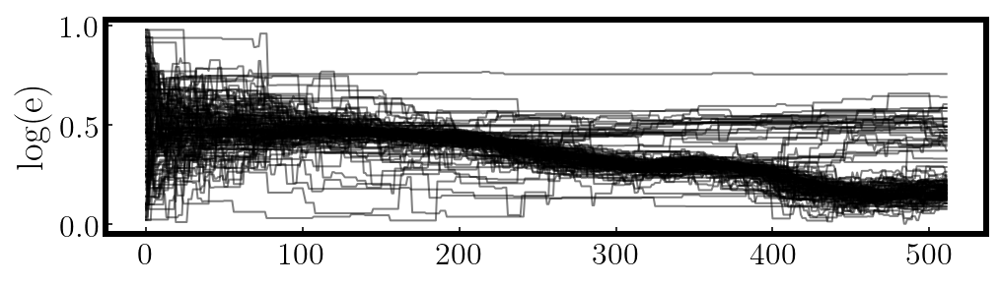

...

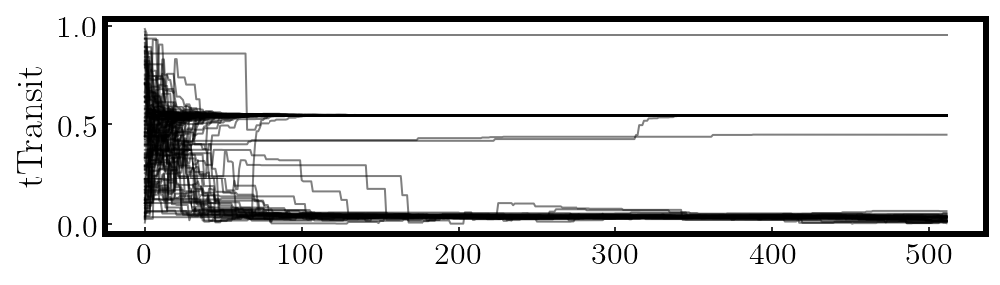

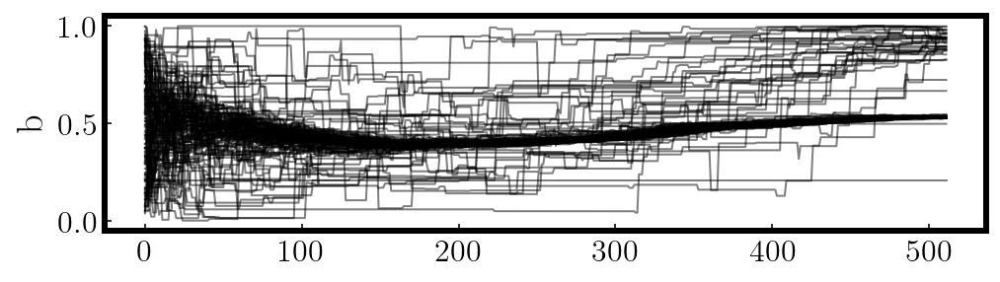

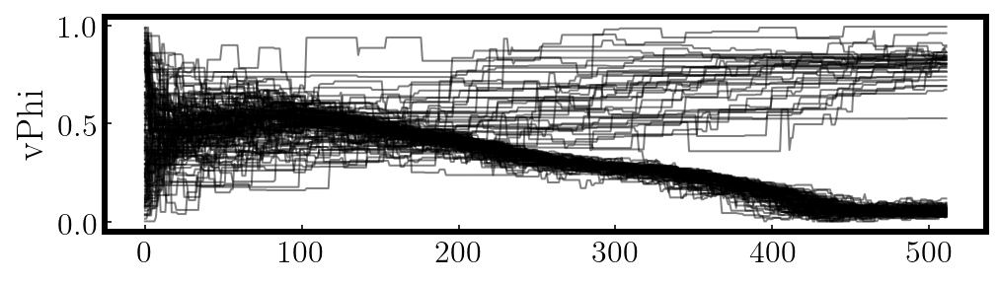

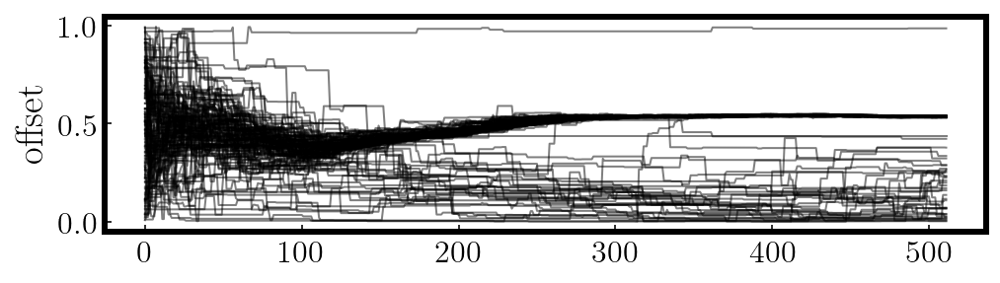

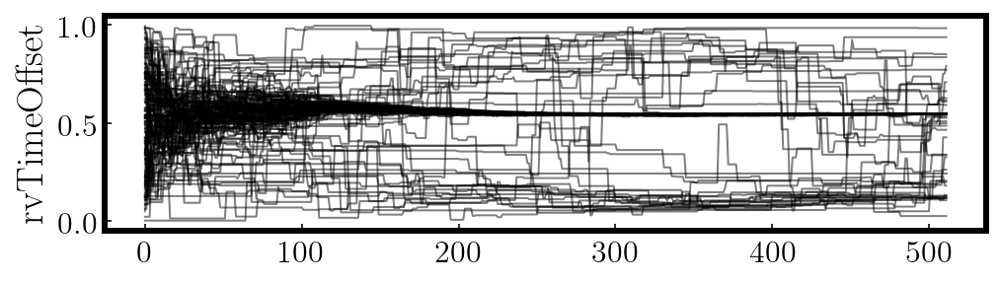

In [158]:
for i in range(11):
    fig = plt.figure(figsize=(8,2))
    thisPlot=plt.gca()
    for j in range(nwalkers):
        thisPlot.plot(sampler.chain[j,:,i],lw=1,c='k',alpha=0.5)
    thisPlot.set_ylabel(labels[i])
    plt.show()

In [156]:
print(samples.shape)

(65536, 11)
